<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Pre-processing-VDJdb" data-toc-modified-id="Pre-processing-VDJdb-1">Pre-processing VDJdb</a></span><ul class="toc-item"><li><span><a href="#1.-Load-the-packages-and-data" data-toc-modified-id="1.-Load-the-packages-and-data-1.1">1. Load the packages and data</a></span></li><li><span><a href="#2.-Data-describtion" data-toc-modified-id="2.-Data-describtion-1.2">2. Data describtion</a></span></li><li><span><a href="#3.-Data-wrangling" data-toc-modified-id="3.-Data-wrangling-1.3">3. Data wrangling</a></span><ul class="toc-item"><li><span><a href="#3.1-Remove-columns" data-toc-modified-id="3.1-Remove-columns-1.3.1">3.1 Remove columns</a></span></li><li><span><a href="#3.2-Null-values" data-toc-modified-id="3.2-Null-values-1.3.2">3.2 Null values</a></span></li><li><span><a href="#3.3-Unique-values" data-toc-modified-id="3.3-Unique-values-1.3.3">3.3 Unique values</a></span></li><li><span><a href="#3.4-complex.id" data-toc-modified-id="3.4-complex.id-1.3.4">3.4 complex.id</a></span></li></ul></li><li><span><a href="#4.-Inference" data-toc-modified-id="4.-Inference-1.4">4. Inference</a></span><ul class="toc-item"><li><span><a href="#4.1-TCRdist3" data-toc-modified-id="4.1-TCRdist3-1.4.1">4.1 TCRdist3</a></span></li><li><span><a href="#4.2-GLIPH" data-toc-modified-id="4.2-GLIPH-1.4.2">4.2 GLIPH</a></span></li><li><span><a href="#4.3-GIANA" data-toc-modified-id="4.3-GIANA-1.4.3">4.3 GIANA</a></span></li></ul></li></ul></li><li><span><a href="#Task3" data-toc-modified-id="Task3-2">Task3</a></span></li><li><span><a href="#1.-TCRdist" data-toc-modified-id="1.-TCRdist-3">1. TCRdist</a></span><ul class="toc-item"><li><span><a href="#1.1-Load-the-package" data-toc-modified-id="1.1-Load-the-package-3.1">1.1 Load the package</a></span></li><li><span><a href="#1.2-Format-the-data" data-toc-modified-id="1.2-Format-the-data-3.2">1.2 Format the data</a></span><ul class="toc-item"><li><span><a href="#1.2.1-Add-'clone_id'" data-toc-modified-id="1.2.1-Add-'clone_id'-3.2.1">1.2.1 Add 'clone_id'</a></span></li><li><span><a href="#1.2.2-Duplicate-complex.id-0-records" data-toc-modified-id="1.2.2-Duplicate-complex.id-0-records-3.2.2">1.2.2 Duplicate complex.id 0 records</a></span></li><li><span><a href="#1.2.3-Add-'count'" data-toc-modified-id="1.2.3-Add-'count'-3.2.3">1.2.3 Add 'count'</a></span></li><li><span><a href="#1.2.4-Select-the-columns-for-TCRdist-input" data-toc-modified-id="1.2.4-Select-the-columns-for-TCRdist-input-3.2.4">1.2.4 Select the columns for TCRdist input</a></span></li><li><span><a href="#1.2.5-Fill-null-values-and-pivot-wider" data-toc-modified-id="1.2.5-Fill-null-values-and-pivot-wider-3.2.5">1.2.5 Fill null values and pivot wider</a></span></li><li><span><a href="#1.2.6-Select-'organism':" data-toc-modified-id="1.2.6-Select-'organism':-3.2.6">1.2.6 Select 'organism':</a></span></li><li><span><a href="#1.2.7-Formatted-input" data-toc-modified-id="1.2.7-Formatted-input-3.2.7">1.2.7 Formatted input</a></span></li></ul></li><li><span><a href="#1.3-Similarity/Distance-matrix" data-toc-modified-id="1.3-Similarity/Distance-matrix-3.3">1.3 Similarity/Distance matrix</a></span><ul class="toc-item"><li><span><a href="#1.3.1-Different-inputs" data-toc-modified-id="1.3.1-Different-inputs-3.3.1">1.3.1 Different inputs</a></span></li><li><span><a href="#1.3.2-Define-functions" data-toc-modified-id="1.3.2-Define-functions-3.3.2">1.3.2 Define functions</a></span></li><li><span><a href="#1.3.3-Alpha-and-beta-chains-separately" data-toc-modified-id="1.3.3-Alpha-and-beta-chains-separately-3.3.3">1.3.3 Alpha and beta chains separately</a></span></li><li><span><a href="#1.3.4-Pairwise" data-toc-modified-id="1.3.4-Pairwise-3.3.4">1.3.4 Pairwise</a></span></li><li><span><a href="#1.3.5-Results-evaluation" data-toc-modified-id="1.3.5-Results-evaluation-3.3.5">1.3.5 Results evaluation</a></span></li></ul></li></ul></li></ul></div>

# Pre-processing VDJdb

## 1. Load the packages and data

In [1]:
import pandas as pd
import numpy as np
from IPython.display import display
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
rawdata = pd.read_excel('vdjdb.xlsx')

In [3]:
rawdata.head(3)

,complex.id,gene,cdr3,v.segm,j.segm,species,mhc.a,mhc.b,mhc.class,antigen.epitope,...,antigen.species,reference.id,method,meta,cdr3fix,vdjdb.score,web.method,web.method.seq,web.cdr3fix.nc,web.cdr3fix.unmp
0,1,TRA,CIVRAPGRADMRF,TRAV26-1*01,TRAJ43*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,...,HIV-1,PMID:15596521,"{""frequency"": """", ""identification"": ""tetramer-...","{""cell.subset"": ""CD8+"", ""clone.id"": """", ""donor...","{""cdr3"": ""CIVRAPGRADMRF"", ""cdr3_old"": ""CIVRAPG...",2,sort,sanger,no,no
1,1,TRB,CASSYLPGQGDHYSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,...,HIV-1,PMID:15596521,"{""frequency"": """", ""identification"": ""tetramer-...","{""cell.subset"": ""CD8+"", ""clone.id"": """", ""donor...","{""cdr3"": ""CASSYLPGQGDHYSNQPQHF"", ""cdr3_old"": ""...",2,sort,sanger,no,no
2,0,TRB,CASSFEAGQGFFSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,...,HIV-1,PMID:15596521,"{""frequency"": """", ""identification"": ""tetramer-...","{""cell.subset"": ""CD8+"", ""clone.id"": """", ""donor...","{""cdr3"": ""CASSFEAGQGFFSNQPQHF"", ""cdr3_old"": ""C...",2,sort,sanger,no,no


In [4]:
rawdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92771 entries, 0 to 92770
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   complex.id        92771 non-null  int64 
 1   gene              92771 non-null  object
 2   cdr3              92771 non-null  object
 3   v.segm            92670 non-null  object
 4   j.segm            91626 non-null  object
 5   species           92771 non-null  object
 6   mhc.a             92771 non-null  object
 7   mhc.b             92771 non-null  object
 8   mhc.class         92771 non-null  object
 9   antigen.epitope   92771 non-null  object
 10  antigen.gene      92709 non-null  object
 11  antigen.species   92771 non-null  object
 12  reference.id      91260 non-null  object
 13  method            92771 non-null  object
 14  meta              92771 non-null  object
 15  cdr3fix           92771 non-null  object
 16  vdjdb.score       92771 non-null  int64 
 17  web.method  

In [5]:
# dtype_df = pd.DataFrame(columns=['Column', 'Data Type'])

# for column in rawdata.columns:
#     data_type = type(rawdata[column][0]).__name__
#     dtype_df = pd.concat([dtype_df, pd.DataFrame({'Column': [column], 'Data Type': [data_type]})], ignore_index=True)

# print(dtype_df)

## 2. Data describtion

From the data type of each column we can see that all are of type **str** except *conplex.id* and *vdjdb.score* which are of type **int**.

The data contains a total of 21 columns, we can make an initial filter by the type and meaning of each column.

In [6]:
rawdata_info = pd.read_excel('vdjdb.xlsx', sheet_name='Sheet2')

In [7]:
def display_left_aligned(df):
    style = df.style.set_properties(**{
        'text-align': 'left',
        'white-space': 'pre-wrap',
    })

    style.set_table_styles([{
        'selector': 'th',
        'props': [('text-align', 'left')]
    }])

    display(style)

In [8]:
display_left_aligned(rawdata_info)

,Column Name,Data Type,Description
0,complex.id,int64,"TCR id: 1. TCR alpha and beta chain records belonging to the same T-cell clone. 2. In case complex.id is equal to 0, a record doesn't have either alpha or beta chain."
1,gene,str,TCR chain as alpha or beta
2,cdr3,str,TCR Complementarity Determining Region 3 (CDR3) amino acid sequence
3,v.segm,str,TCR Variable (V) segment
4,j.segm,str,TCR Joining (J) gene segment
5,species,str,TCR parent species
6,mhc.a,str,First MHC chain allele
7,mhc.b,str,Second MHC chain allele (MHC I: beta2-microglobulin )
8,mhc.class,str,MHC I or MHC II
9,antigen.epitope,str,Amino acid sequence of the epitope


## 3. Data wrangling

### 3.1 Remove columns

Some of the columns contain specific information about the literature sources (reference.id), sequencing methods (method, web.method.seq), collection method (web.method) etc., some of which are related to how **vdjdb.score** is calculated.

Therefore we first remove these columns. Deleted columns are as follows: 
-  reference.id
-  method
-  meta
-  cdr3fix
-  web.method  
-  web.method.seq
-  web.cdr3fix.nc
-  web.cdr3fix.unmp

In [9]:
data = rawdata.iloc[:, list(range(0, 12)) + [16]]
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92771 entries, 0 to 92770
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   complex.id       92771 non-null  int64 
 1   gene             92771 non-null  object
 2   cdr3             92771 non-null  object
 3   v.segm           92670 non-null  object
 4   j.segm           91626 non-null  object
 5   species          92771 non-null  object
 6   mhc.a            92771 non-null  object
 7   mhc.b            92771 non-null  object
 8   mhc.class        92771 non-null  object
 9   antigen.epitope  92771 non-null  object
 10  antigen.gene     92709 non-null  object
 11  antigen.species  92771 non-null  object
 12  vdjdb.score      92771 non-null  int64 
dtypes: int64(2), object(11)
memory usage: 9.2+ MB


### 3.2 Null values

The colums v.segm and j.segm have 101, 1145 null values respectively. Due to the fact 

In [10]:
data.isnull().sum()

complex.id            0
gene                  0
cdr3                  0
v.segm              101
j.segm             1145
species               0
mhc.a                 0
mhc.b                 0
mhc.class             0
antigen.epitope       0
antigen.gene         62
antigen.species       0
vdjdb.score           0
dtype: int64

In [11]:
null_count = data.isnull().any(axis=1).sum()
print(f"The number of null rows: {null_count}")

The number of null rows: 1221


### 3.3 Unique values

Then, we check the unique value counts in the remaining columns.

In [12]:
def plot_unique_value_counts(df, wid):
    unique_counts = df.nunique()
    showplt = 1
    ##showplt = input('If you want to show a bar chart, please input 1.\nElse, input 0:\n')
    if showplt:
        plt.figure(figsize=(6, 4))
        plt.bar(range(len(unique_counts)),unique_counts, width=wid)
        plt.title('Unique Value Counts')
        plt.xlabel('Columns')
        plt.ylabel('Unique Value Counts')
        plt.xticks(range(len(unique_counts)), unique_counts.index, rotation=45)

    for i, v in enumerate(unique_counts):
        plt.text(i, v + 0.1, str(v), ha='center', va='bottom')

    return unique_counts

complex.id         30595
gene                   2
cdr3               68994
v.segm               224
j.segm                71
species                3
mhc.a                119
mhc.b                 45
mhc.class              2
antigen.epitope     1169
antigen.gene         268
antigen.species       42
vdjdb.score            4
dtype: int64

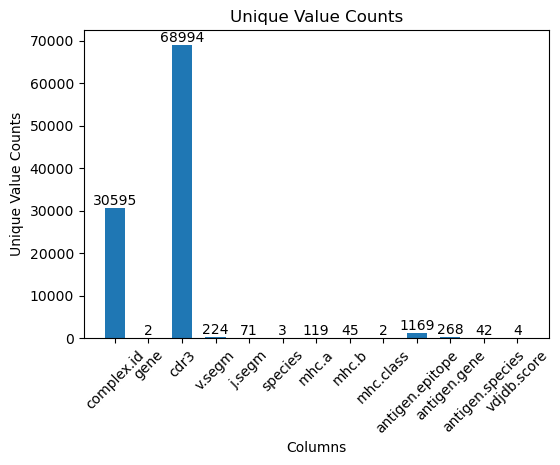

In [13]:
plot_unique_value_counts(data,0.6)

cdr3               68994
antigen.epitope     1169
dtype: int64

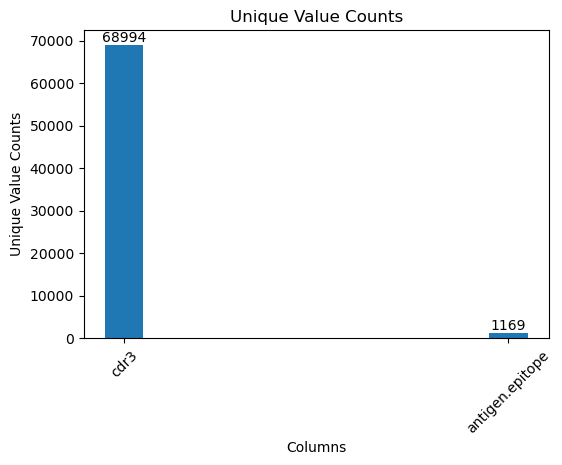

In [14]:
plot_unique_value_counts(data[['cdr3','antigen.epitope']],0.1)

### 3.4 complex.id

Due to the fact that TCR alpha and beta chain records belonging to the same T-cell clone, and in case the complex.id is equal to zero, a record doesn't have either alpha or beta chain, we count both zero and non-zero values, and then check if the non-zero values occur twice.

In [15]:
print(f"1. The number of rows in the VDJdb: {len(data)}\n"
      f"   The number of null rows: {null_count}\n"
      f"   The number of duplicate rows: {len(data)-data.drop_duplicates().shape[0]}")

zeros = data[data['complex.id'] == 0]
zeros_count = zeros['complex.id'].count()
zeros_a_count = zeros[zeros['gene'] == 'TRA']['gene'].count()
zeros_b_count = zeros[zeros['gene'] == 'TRB']['gene'].count()
zeros_unique_count = zeros.drop_duplicates().shape[0]
zeros_null = zeros.isnull().any(axis=1).sum()
print("\n2. The zero complex.id info:"
      f"\n   The number of zero complex.id: {zeros_count}"
      f"\n   The number of the alpha chain: {zeros_a_count}"
      f"\n   The number of the beta chain: {zeros_b_count}"
      f"\n   The number of non-duplicate rows: {zeros_unique_count}"
      f"\n   The number of duplicate rows: {zeros_count-zeros_unique_count}"
      f"\n   The number of null rows: {zeros_null}")


non_zeros = data[data['complex.id'] != 0]
non_zeros_count = non_zeros['complex.id'].count()
non_zeros_pair_count = non_zeros['complex.id'].value_counts()
non_zeros_unique_count = non_zeros.drop_duplicates().shape[0]
non_zeros_null = non_zeros.isnull().any(axis=1).sum()
print("\n3. The non-zero complex.id info:"
      f"\n   The number of non-zero complex.id: {non_zeros_count}"
      f"\n   The number of non-duplicate rows: {non_zeros_unique_count}"
      f"\n   The number of duplicate rows: {non_zeros_count-non_zeros_unique_count}")

# Check if all non-zero values occur twice
pairs_check = all(non_zeros_pair_count == 2)
if pairs_check:
    print(f"\n   All non-zero values occur in pairs."
          f"\n   The number of the paired values is {len(non_zeros_pair_count)}")
else:
    print("\n   There are non-paired values among non-zero values.")

# Find non-duplicate rows with null values in non_zeros
complex_id_with_null = non_zeros.loc[non_zeros.isnull().any(axis=1), [
    'complex.id']]

print(f"\n   The number of null rows: {non_zeros_null}"
      f"\n   The number of duplicate rows with null: "
      f"{non_zeros_null-complex_id_with_null.drop_duplicates().shape[0]}")

1. The number of rows in the VDJdb: 92771
   The number of null rows: 1221
   The number of duplicate rows: 4245

2. The zero complex.id info:
   The number of zero complex.id: 31583
   The number of the alpha chain: 7455
   The number of the beta chain: 24128
   The number of non-duplicate rows: 27338
   The number of duplicate rows: 4245
   The number of null rows: 326

3. The non-zero complex.id info:
   The number of non-zero complex.id: 61188
   The number of non-duplicate rows: 61188
   The number of duplicate rows: 0

   All non-zero values occur in pairs.
   The number of the paired values is 30594

   The number of null rows: 895
   The number of duplicate rows with null: 32


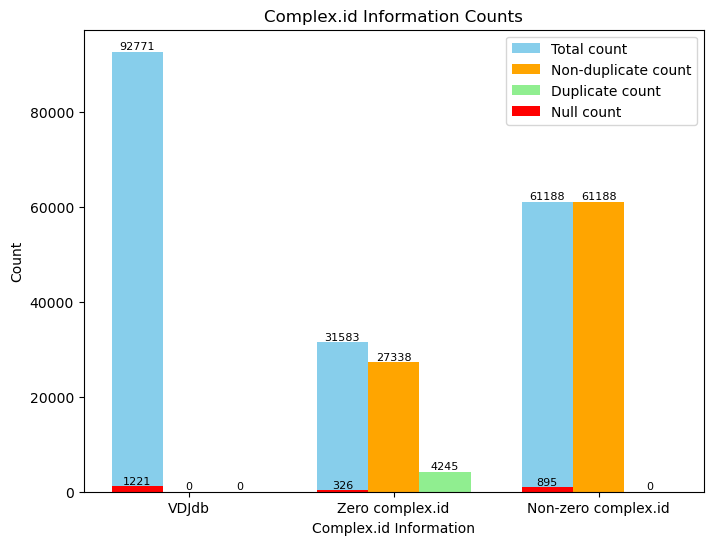

In [16]:
# complex.id info visualization
# Define data
categories = ['VDJdb', 'Zero complex.id', 'Non-zero complex.id']
counts = [len(data), zeros_count, non_zeros_count]
unique_counts = [0, zeros_unique_count, non_zeros_unique_count]
duplicate_counts = [0, zeros_count - zeros_unique_count, non_zeros_count - non_zeros_unique_count]
null_counts = [null_count, zeros_null, non_zeros_null]

# Create a bar chart
plt.figure(figsize=(8, 6))
bar_width = 0.25
index = range(len(categories))

bars1 = plt.bar(index, counts, color='skyblue', label='Total count', width=bar_width)
bars2 = plt.bar([i + bar_width for i in index], unique_counts, color='orange', label='Non-duplicate count', width=bar_width)
bars3 = plt.bar([i + 2 * bar_width for i in index], duplicate_counts, color='lightgreen', label='Duplicate count', width=bar_width)
barsnull = plt.bar(index, null_counts, color='red', label='Null count', width=bar_width)

# Add labels and legend
def autolabel(bars):
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height, '%d' % int(height), ha='center', va='bottom', fontsize=8)

autolabel(bars1)
autolabel(bars2)
autolabel(bars3)
autolabel(barsnull)

plt.xlabel('Complex.id Information')
plt.ylabel('Count')
plt.title('Complex.id Information Counts')
plt.xticks([i + bar_width for i in index], categories)
plt.legend()

Next, we check if the paired records of non-zero complex.id have the same information for other columns expect the column 'gene'.

In [17]:
grouped = non_zeros.groupby('complex.id')

# Create an empty list to store inconsistent complex.id
not_consistent_ids = []

for group_name, group_data in grouped:
    # Compare columns 6 to 13 for consistency
    columns_to_compare = group_data.columns[5:13]
    comparison_result = group_data.iloc[0][columns_to_compare].equals(
        group_data.iloc[1][columns_to_compare])

    if not comparison_result:
        not_consistent_ids.append(group_name)

if not_consistent_ids:
    print("Inconsistent complex.id:", not_consistent_ids)
else:
    print(
        f"All {', '.join(non_zeros.columns[5:13])} columns of the same complex.id are consistent.")

All species, mhc.a, mhc.b, mhc.class, antigen.epitope, antigen.gene, antigen.species, vdjdb.score columns of the same complex.id are consistent.


## 4. Inference

Based on various measures we could use to calculate the distance/similarity matrix, the columns we choose as the input are different. Besides we should calculate these metrics for the alpha and beta chains seperately in the further study.

**Therefore we don't have to remove the lines with null values and complex.id values that are equal to 0 right away.**

### 4.1 TCRdist3

Tcrdist3 only requires 3 input columns for single chain analysis (i.e., for beta chain cdr3_b_aa and v_b_gene, j_b_gene) and 6 columns for paired chain analysis (i.e., cdr3_b_aa, v_b_gene, j_b_gene, cdr3_a_aa, v_a_gene, and j_a_gene).

A unique feature of tcrdist3 is that all of the parameters of the distance metric can be adjusted (e.g. alpha-chain only, weights on CDR loops, etc.) or completely new user-defined metrics can be provided to calculate pairwise distances. The package comes with a distance based on Needleman-Wunsch global sequence alignment and a BLOSUM62 similarity matrix, as well as the Levenshtein/edit distance, which is employed by other TCR analysis packages such as *TCRNET/VDJtools*, *ALICE*, and *GLIPH2*.

https://tcrdist3.readthedocs.io/en/latest/index.html

https://github.com/kmayerb/tcrdist3

### 4.2 GLIPH

Input TCR data are formated as follow
#CDR3b  TRBV  TRBJ  CDR3a  subject:condition count
CSARDQGGAGNQPQHF	TRBV20-1	TRBJ1-5	CAVGVGYKLSF	01/0906:MtbLys	1

All fields are tab-delimited except that subject and condition are delimited with ":". Condition can be anything such as tissue type, cell subset or treatment et al. CDR3b, TRBV, subject, and count are required. Other fields can be replaced with "NA". A demo input TCR dataset can be found at the link [TCR](http://50.255.35.37:8080/demo).

Huang, Huang, et al. "Analyzing the Mycobacterium tuberculosis immune response by T-cell receptor clustering with GLIPH2 and genome-wide antigen screening." Nature Biotechnology 38.10 (2020): 1194-1202. [Link](https://www.nature.com/articles/s41587-020-0505-4)

GLIPH1 works well on small and clean data sets. However, as data sets are becoming larger and noisier, the algorithm tends to generate large clusters of mixed specificities. [Link](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10035763/)

http://50.255.35.37:8080/tools

https://github.com/immunoengineer/gliph

### 4.3 GIANA

Input of GIANA is flexible. The first column is kept for CDR3 amino acid sequence. If TRBV allele information is enabled (by default), the second column is required to be TRBV genes. As the TCR-seq data provided by the Adaptive Biotechnologies does not comply with the IMGT format, we provide the R code (ProcessAdaptiveFile.R) to convert the Adaptive data input to standard format. In the output, GIANA inserts a column between the first and the second column as the cluster IDs. Other columns in the input data may contain any information, and will be kept in the final output.

https://github.com/s175573/GIANA

# Task3

# 1. TCRdist

## 1.1 Load the package

In [18]:
from tcrdist.repertoire import TCRrep

In [19]:
# from tcrdist.setup_tests import list_available_zip_files  
# list_available_zip_files()
# """
# ['dash.zip',
# 'human_T_alpha_beta_sim200K.zip',
# 'vdjDB_PMID28636592.zip',
# 'sant.csv.zip',
# 'bulk.csv.zip',
# 'wiraninha_sampler.zip',
# 'ruggiero_mouse_sampler.zip',
# 'ruggiero_human_sampler.zip',
# 'britanova_human_beta_t_cb.tsv.sampler.tsv.zip',
# 'emerson_human_beta_t_cmvneg.tsv.sampler.tsv.zip',
# 'ruggiero_human_alpha_t.tsv.sampler.tsv.zip',
# 'ruggiero_human_beta_t.tsv.sampler.tsv.zip']
# """
# from tcrdist.setup_tests import download_and_extract_zip_file
# """
# Get dash.zip contents
# """
# download_and_extract_zip_file( 'dash.zip', source = "dropbox", dest = ".")
# """
# Assert that file has been downloaded
# """
# import os
# assert os.path.isfile("dash.zip")
# """
# Assert that individual files of successively been inflated
# """
# assert os.path.isfile("dash.csv")
# assert os.path.isfile("dash2.csv")
# assert os.path.isfile("dash_human.csv")
# assert os.path.isfile("dash_beta_airr.csv")

## 1.2 Format the data

### 1.2.1 Add 'clone_id'

Add a column of **'clone_id'** to all rows in data. And the value is: 

- zero complex.id records: clone_0_{number of rows in the original record}
- non-zero complex.id records: complex_1_{clone.id of the original record}

In [20]:
#data = rawdata.iloc[:, list(range(0, 12)) + [16]]

In [21]:
# Add a column of 'clone_id' to all rows
data['clone_id'] = ''

# Give the 'clone_id' record with zero complex.id the value:
# clone_0_{number of rows in the original record}
zero_complex_ids = data[data['complex.id'] == 0].index
data.loc[zero_complex_ids, 'clone_id'] = zero_complex_ids.map(
    lambda x: f'clone_0_{x}')

# Give the 'clone_id' record with non-zero complex.id the value:
# clone_1_{complex.id of the original record}
non_zero_complex_ids = data[data['complex.id'] != 0]['complex.id'].unique()
for complex_id in non_zero_complex_ids:
    indices = data[data['complex.id'] == complex_id].index
    data.loc[indices, 'clone_id'] = f'clone_1_{complex_id}'

C:\Users\86139\AppData\Local\Temp\ipykernel_1500\3019494910.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['clone_id'] = ''


### 1.2.2 Duplicate complex.id 0 records 

Duplicate the records with complex.id of 0 and modify the gene columns.

In [22]:
data_copy = data[data['complex.id'] == 0].copy()
data_copy['gene'] = data_copy['gene'].map({'TRA': 'TRB', 'TRB': 'TRA'})

In [23]:
# set all columns except 'complex.id', 'clone_id' and the modified 'gene' column to e,.
for col in data_copy.columns:
    if col not in ['complex.id', 'species', 'antigen.gene', 'count', 'clone_id','gene']:
        data_copy[col] = np.nan

# Merge original and copied data
data_copy = pd.concat([data, data_copy], ignore_index=True)

In [24]:
data_copy[data_copy['complex.id']!=0]

,complex.id,gene,cdr3,v.segm,j.segm,species,mhc.a,mhc.b,mhc.class,antigen.epitope,antigen.gene,antigen.species,vdjdb.score,clone_id
0,1,TRA,CIVRAPGRADMRF,TRAV26-1*01,TRAJ43*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,Nef,HIV-1,2.0,clone_1_1
1,1,TRB,CASSYLPGQGDHYSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,Nef,HIV-1,2.0,clone_1_1
3,2,TRA,CAVPSGAGSYQLTF,TRAV20*01,TRAJ28*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,Nef,HIV-1,2.0,clone_1_2
4,2,TRB,CASSFEPGQGFYSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,Nef,HIV-1,2.0,clone_1_2
5,3,TRA,CAVKASGSRLT,TRAV2*01,NaN,HomoSapiens,HLA-B*08,B2M,MHCI,FLKEKGGL,Nef,HIV-1,2.0,clone_1_3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92766,30592,TRB,CASSPGQGGDNEQFF,TRBV7-3*01,TRBJ2-1*01,HomoSapiens,HLA-DQA1*05:01,HLA-DQB1*02:01,MHCII,PQQPFPQPEQPFP,Gluten,Wheat,0.0,clone_1_30592
92767,30593,TRA,CAPQGATNKLIF,TRAV12-2*01,TRAJ32*01,HomoSapiens,HLA-DQA1*05:01,HLA-DQB1*02:01,MHCII,PQQPFPQPEQPFP,Gluten,Wheat,2.0,clone_1_30593
92768,30593,TRB,CASSLGAGGQETQYF,TRBV5-1*01,TRBJ2-5*01,HomoSapiens,HLA-DQA1*05:01,HLA-DQB1*02:01,MHCII,PQQPFPQPEQPFP,Gluten,Wheat,2.0,clone_1_30593
92769,30594,TRA,CLVGGSGGYNKLIF,TRAV4*01,TRAJ4*01,HomoSapiens,HLA-DQA1*05:01,HLA-DQB1*02:01,MHCII,PQQPFPQPEQPFP,Gluten,Wheat,0.0,clone_1_30594


### 1.2.3 Add 'count'

Set 'count' of all rows to 1

In [25]:
data_copy['count'] = 1

### 1.2.4 Select the columns for TCRdist input

The tcrdist3 standard input is a Pandas DataFrame.

The header and first line of a typical input for a beta-chain analysis would look like this:


| subject | epitope | count | v_b_gene | j_b_gene |
|---------|---------|-------|----------|----------|
| s1      | NP      | 1     | TRBV1*01 | TRBJ1-1*01 |

| cdr3_b_aa                | cdr3_b_nucseq                                 |
|--------------------------|-----------------------------------------------|
| CACDSLGDKSSWDTRQMFF      | TGTGCCTGTGACTCGCTGGGGGATAAGAGCTCCTGGGACACCCGACAGATGTTTTTC |



- Tcrdist3 only requires 3 input columns for single chain analysis (i.e., **for beta chain cdr3_b_aa and v_b_gene, j_b_gene**) and 6 columns for paired chain analysis (i.e., **cdr3_b_aa, v_b_gene, j_b_gene, cdr3_a_aa, v_a_gene, and j_a_gene**).

- The columns **‘cdr3_a_nucseq’, ‘cdr3_b_nucseq’ are optional**, but useful to include if you wish to prevent aggregation of multiple geneically distinct clones identical at the amino acid level (see critical information below for more information).

- By default, tcrdist3 uses all supplied columns provided in the DataFrame passed to the cell_df argument to look for potentially **duplicated rows** based on the default setting (deduplicate = True). The initialization of a TCRrep instance automatically aggregates counts over duplicated rows.

- This has practical consequences. For instance, if **no subject** column is included identical clones from two or more individuals will be **combined into a single row**.

- If any columns have *missing values*, the corresponding row containing the **missing value** is excluded. Thus, do not include columns that have missing values. If you wish to retain every clonotype, adding an index column or the nucleotide sequence will prevent rows with identical amino acid sequences from being merged.

**The standard input in the dash.csv looks like this:**

In [26]:
pd.read_csv("dash.csv").head(3)

,subject,epitope,count,v_a_gene,j_a_gene,cdr3_a_aa,cdr3_a_nucseq,v_b_gene,j_b_gene,cdr3_b_aa,cdr3_b_nucseq,clone_id
0,mouse_subject0050,PA,2,TRAV7-3*01,TRAJ33*01,CAVSLDSNYQLIW,tgtgcagtgagcctcgatagcaactatcagttgatctgg,TRBV13-1*01,TRBJ2-3*01,CASSDFDWGGDAETLYF,tgtgccagcagtgatttcgactggggaggggatgcagaaacgctgt...,mouse_tcr0072.clone
1,mouse_subject0050,PA,6,TRAV6D-6*01,TRAJ56*01,CALGDRATGGNNKLTF,tgtgctctgggtgacagggctactggaggcaataataagctgactttt,TRBV29*01,TRBJ1-1*01,CASSPDRGEVFF,tgtgctagcagtccggacaggggtgaagtcttcttt,mouse_tcr0096.clone
2,mouse_subject0050,PA,1,TRAV6D-6*01,TRAJ49*01,CALGSNTGYQNFYF,tgtgctctgggctcgaacacgggttaccagaacttctatttt,TRBV29*01,TRBJ1-5*01,CASTGGGAPLF,tgtgctagcacagggggaggggctccgcttttt,mouse_tcr0276.clone


In [27]:
df = data_copy.iloc[:, list(range(0, 6)) + [9,12,13,14]]

In [28]:
df[df['complex.id']!=0]

,complex.id,gene,cdr3,v.segm,j.segm,species,antigen.epitope,vdjdb.score,clone_id,count
0,1,TRA,CIVRAPGRADMRF,TRAV26-1*01,TRAJ43*01,HomoSapiens,FLKEKGGL,2.0,clone_1_1,1
1,1,TRB,CASSYLPGQGDHYSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKEKGGL,2.0,clone_1_1,1
3,2,TRA,CAVPSGAGSYQLTF,TRAV20*01,TRAJ28*01,HomoSapiens,FLKEKGGL,2.0,clone_1_2,1
4,2,TRB,CASSFEPGQGFYSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKEKGGL,2.0,clone_1_2,1
5,3,TRA,CAVKASGSRLT,TRAV2*01,NaN,HomoSapiens,FLKEKGGL,2.0,clone_1_3,1
...,...,...,...,...,...,...,...,...,...,...
92766,30592,TRB,CASSPGQGGDNEQFF,TRBV7-3*01,TRBJ2-1*01,HomoSapiens,PQQPFPQPEQPFP,0.0,clone_1_30592,1
92767,30593,TRA,CAPQGATNKLIF,TRAV12-2*01,TRAJ32*01,HomoSapiens,PQQPFPQPEQPFP,2.0,clone_1_30593,1
92768,30593,TRB,CASSLGAGGQETQYF,TRBV5-1*01,TRBJ2-5*01,HomoSapiens,PQQPFPQPEQPFP,2.0,clone_1_30593,1
92769,30594,TRA,CLVGGSGGYNKLIF,TRAV4*01,TRAJ4*01,HomoSapiens,PQQPFPQPEQPFP,0.0,clone_1_30594,1


In [29]:
df[df['complex.id']==0]

,complex.id,gene,cdr3,v.segm,j.segm,species,antigen.epitope,vdjdb.score,clone_id,count
2,0,TRB,CASSFEAGQGFFSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKEKGGL,2.0,clone_0_2,1
11,0,TRB,CASSFEAGQGFFSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKEQGGL,2.0,clone_0_11,1
18,0,TRB,CASSFEAGQGFFSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKETGGL,2.0,clone_0_18,1
25,0,TRB,CASSFEAGQGFFSNQPQHF,TRBV13*01,TRBJ1-5*01,HomoSapiens,FLKEMGGL,2.0,clone_0_25,1
30,0,TRB,CASSFGVEDEQYF,TRBV7-2*01,TRBJ2-7*01,HomoSapiens,LQPFPQPELPYPQPQ,1.0,clone_0_30,1
...,...,...,...,...,...,...,...,...,...,...
124349,0,TRB,NaN,NaN,NaN,HomoSapiens,NaN,NaN,clone_0_92664,1
124350,0,TRB,NaN,NaN,NaN,HomoSapiens,NaN,NaN,clone_0_92665,1
124351,0,TRB,NaN,NaN,NaN,HomoSapiens,NaN,NaN,clone_0_92666,1
124352,0,TRA,NaN,NaN,NaN,HomoSapiens,NaN,NaN,clone_0_92667,1


### 1.2.5 Fill null values and pivot wider

Based on the column 'gene', we pivot the data wider so that it looks like the standard input. Meanwhile, we change the name of the columns as the TCRdist requires.

**Fill the null values in antigen.gene with the string 'empty'**

In [30]:
df['antigen.epitope'].fillna('empty', inplace=True)
df.isnull().sum()

C:\Users\86139\AppData\Local\Temp\ipykernel_1500\765578289.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['antigen.epitope'].fillna('empty', inplace=True)


complex.id             0
gene                   0
cdr3               31583
v.segm             31684
j.segm             32728
species                0
antigen.epitope        0
vdjdb.score        31583
clone_id               0
count                  0
dtype: int64

In [31]:
df_wide = df.pivot_table(index=['clone_id','complex.id', 'species', 'antigen.epitope', 'vdjdb.score', 'count'], columns='gene', values=[
                         'cdr3', 'v.segm', 'j.segm'], aggfunc='first').reset_index()
# df_wide.columns
df_wide.columns = [f'{col[0]}_{col[1]}' if col[1] else col[0]
                   for col in df_wide.columns]

In [32]:
df_wide.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62177 entries, 0 to 62176
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   clone_id         62177 non-null  object 
 1   complex.id       62177 non-null  int64  
 2   species          62177 non-null  object 
 3   antigen.epitope  62177 non-null  object 
 4   vdjdb.score      62177 non-null  float64
 5   count            62177 non-null  int64  
 6   cdr3_TRA         38049 non-null  object 
 7   cdr3_TRB         54722 non-null  object 
 8   j.segm_TRA       37004 non-null  object 
 9   j.segm_TRB       54622 non-null  object 
 10  v.segm_TRA       37957 non-null  object 
 11  v.segm_TRB       54713 non-null  object 
dtypes: float64(1), int64(2), object(9)
memory usage: 5.7+ MB


In [33]:
df_wide.columns = ['clone_id', 'complex_id', 'organism', 'epitope','vdjdb_score', 'count', 'cdr3_a_aa',
                   'cdr3_b_aa', 'j_a_gene', 'j_b_gene', 'v_a_gene', 'v_b_gene']

In [34]:
len(df_wide)

62177

In [35]:
len(df_wide[df_wide['complex_id'] ==0])

31583

In [36]:
len(df_wide[df_wide['complex_id'] !=0])

30594

**Check if any rows are deleted:**

**Note**: For the initial trials, we could see that there are some rows with non-zero complex_id missing. Missing values in 'complex_id':

        [ 178,  187,  188,  189,  190,  201,  202,  203,  229,  234,  262,306,  308,  310,  314,  
        
        320,  322, 1621, 1622, 1623, 1624, 1625, 1626, 1627, 1628, 1629, 1630, 1631, 1632, 1633, 1634]
        
By checking the data in the original dataset, we figured out that it's due to the null values in the 'antigen.gene' ('epitope') column. **There should not be null values in the index columns** that will be used for **pivot_table**. 


Therefore we decided to:
- fill the null values in 'antigen.gene' with the string 'empty'.
- change those 'empty' strings in the 'epitope' back to null after the pivot wide step. 

In [37]:
print(f"1. The number of rows in the pivot wide data: {len(df_wide)}\n"
      "\n2. The zero complex.id info:"
      f"\n   The number of zero complex.id in the VDJdb: {zeros_count}"
      f"\n   The number of zero complex.id in the pivot wide data: {len(df_wide[df_wide['complex_id'] ==0])}\n"
      "\n3. The non-zero complex.id info:"
      f"\n   The number of paired non-zero complex.id: {int(non_zeros_count/2)}"
      f"\n   The number of non-zero complex.id in the pivot wide data: {len(df_wide[df_wide['complex_id'] !=0])}")

1. The number of rows in the pivot wide data: 62177

2. The zero complex.id info:
   The number of zero complex.id in the VDJdb: 31583
   The number of zero complex.id in the pivot wide data: 31583

3. The non-zero complex.id info:
   The number of paired non-zero complex.id: 30594
   The number of non-zero complex.id in the pivot wide data: 30594


In [38]:
# Create a Series containing all values from 1 to 30594
all_values = pd.Series(range(1, 30595))

# Found a value that is not in the 'complex_id' column
missing_values = all_values[~all_values.isin(df_wide['complex_id'])]

print("Missing values in 'complex_id' from 1 to 30594:")
print(missing_values)

Missing values in 'complex_id' from 1 to 30594:
Series([], dtype: int64)


**Change those 'empty' strings in the 'epitope' column back to null**

In [39]:
df_wide.replace('empty', np.nan, inplace=True)

###  1.2.6 Select 'organism':

Most classes and functions in tcrdist3 require specification of an appropriate host organism. Currently **only ‘human’ or ‘mouse’ are supported**. This is required because reference TCR genes are organism specific. [link](https://tcrdist3.readthedocs.io/en/latest/inputs.html?highlight=mouse#organism)

Therefore, we obeserve the unique values in the 'organism' column.

In [40]:
df_wide['organism'].value_counts()

HomoSapiens      56985
MusMusculus       3073
MacacaMulatta     2119
Name: organism, dtype: int64

- **Homo sapiens** is the scientific name for modern humans.


- **Mus musculus** is the scientific name for the common house mouse.


- **Macaca mulatta** is the scientific name for the rhesus macaque, which is a species of monkey.


Therefore, we select only 'Homo sapiens' and 'Mus musculus', which will remove line 2073 'MacacaMulatta'. 

Also we change the names to 'modern humans' and 'mouse' respectively.

In [41]:
df_filtered = df_wide[df_wide['organism'].isin(
    ['HomoSapiens', 'MusMusculus'])].copy()

df_filtered.loc[df_filtered['organism'] ==
                'HomoSapiens', 'organism'] = 'human'
df_filtered.loc[df_filtered['organism'] ==
                'MusMusculus', 'organism'] = 'mouse'
df_filtered.head(3)

,clone_id,complex_id,organism,epitope,vdjdb_score,count,cdr3_a_aa,cdr3_b_aa,j_a_gene,j_b_gene,v_a_gene,v_b_gene
0,clone_0_100,0,human,LLQTGIHVRVSQPSL,0.0,1,NaN,CASTSGSFTGELFF,NaN,TRBJ2-2*01,NaN,TRBV5-1*01
1,clone_0_1000,0,human,KRWIILGLNK,0.0,1,NaN,CAWSLTGMNQPQHF,NaN,TRBJ1-5*01,NaN,TRBV30*01
2,clone_0_10000,0,human,NLVPMVATV,0.0,1,NaN,CASSQEALTGAKNIQYF,NaN,TRBJ2-4*01,NaN,TRBV4-3*01


### 1.2.7 Formatted input

In [42]:
tcrdist_input = df_filtered

# Sort by value of column 'epitope'
tcrdist_input.sort_values(by='epitope', inplace=True)

tcrdist_input.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 60058 entries, 37285 to 53194
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   clone_id     60058 non-null  object 
 1   complex_id   60058 non-null  int64  
 2   organism     60058 non-null  object 
 3   epitope      60058 non-null  object 
 4   vdjdb_score  60058 non-null  float64
 5   count        60058 non-null  int64  
 6   cdr3_a_aa    37962 non-null  object 
 7   cdr3_b_aa    52690 non-null  object 
 8   j_a_gene     37004 non-null  object 
 9   j_b_gene     52590 non-null  object 
 10  v_a_gene     37957 non-null  object 
 11  v_b_gene     52681 non-null  object 
dtypes: float64(1), int64(2), object(9)
memory usage: 6.0+ MB


In [43]:
alpha_input = tcrdist_input.iloc[:, [0, 1, 2, 3, 4, 5, 6, 8, 10]]
beta_input = tcrdist_input.iloc[:, [0, 1, 2, 3, 4, 5, 7, 9, 11]]

In [44]:
alpha_input.head()

,clone_id,complex_id,organism,epitope,vdjdb_score,count,cdr3_a_aa,j_a_gene,v_a_gene
37285,clone_1_1513,1513,human,AAFKRSCLK,3.0,1,CVVNGNNNDMRF,TRAJ43*01,TRAV12-1*01
37296,clone_1_1514,1514,human,AAFKRSCLK,3.0,1,CVVNNNNNDMRF,TRAJ43*01,TRAV12-1*01
37307,clone_1_1515,1515,human,AAFKRSCLK,3.0,1,CAGARNDYKLSF,TRAJ20*01,TRAV25*01
37318,clone_1_1516,1516,human,AAFKRSCLK,3.0,1,CALATHTGTASKLTF,TRAJ44*01,TRAV38-1*01
37329,clone_1_1517,1517,human,AAFKRSCLK,3.0,1,CAGAIPRDDKIIF,TRAJ30*01,TRAV27*01


In [45]:
beta_input.head()

,clone_id,complex_id,organism,epitope,vdjdb_score,count,cdr3_b_aa,j_b_gene,v_b_gene
37285,clone_1_1513,1513,human,AAFKRSCLK,3.0,1,CASSQGFGANVLTF,TRBJ2-6*01,TRBV19*01
37296,clone_1_1514,1514,human,AAFKRSCLK,3.0,1,CASVSGQGVSPLHF,TRBJ1-6*01,TRBV19*01
37307,clone_1_1515,1515,human,AAFKRSCLK,3.0,1,CATSRDGAGLVNQPQHF,TRBJ1-5*01,TRBV15*01
37318,clone_1_1516,1516,human,AAFKRSCLK,3.0,1,CASSQDPGSSYNEQFF,TRBJ2-1*01,TRBV4-3*01
37329,clone_1_1517,1517,human,AAFKRSCLK,3.0,1,CASSLNPGRSDSPLHF,TRBJ2-1*01,TRBV7-6*01


## 1.3 Similarity/Distance matrix

### 1.3.1 Different inputs

**Inputs for parwise calculation:**

In [46]:
mouse = tcrdist_input[tcrdist_input['organism'] == 'mouse']
human = tcrdist_input[tcrdist_input['organism'] == 'human']

**Inputs for separate calculation:**

In [47]:
mouse_alpha = alpha_input[alpha_input['organism'] == 'mouse']
mouse_beta = beta_input[alpha_input['organism'] == 'mouse']
human_alpha = alpha_input[alpha_input['organism'] == 'human']
human_beta = beta_input[alpha_input['organism'] == 'human']

**Delete null values:**

In [48]:
mouse = mouse.dropna()
mouse_alpha = mouse_alpha.dropna()
mouse_beta = mouse_beta.dropna()

human = human.dropna()
human_alpha = human_alpha.dropna()
human_beta = human_beta.dropna()

**Number of rows for different vdjdb scores of different inputs:**

In [49]:
# Create a Series containing the vdjdb_score distribution for each dataset
vdjdb_score_counts = {}

datasets = [mouse, mouse_alpha, mouse_beta, human, human_alpha, human_beta]
labels = ['Mouse', 'Mouse Alpha', 'Mouse Beta', 'Human', 'Human Alpha', 'Human Beta']

for dataset, label in zip(datasets, labels):
    vdjdb_score_counts[label] = dataset['vdjdb_score'].value_counts()

# Convert dictionary to DataFrame
vdjdb_score_counts_df = pd.DataFrame(vdjdb_score_counts)
vdjdb_score_counts_df = vdjdb_score_counts_df.rename_axis('vdjdb score')
vdjdb_score_counts_df

,Mouse,Mouse Alpha,Mouse Beta,Human,Human Alpha,Human Beta
vdjdb score,,,,,,
0.0,1282,1322,1810,25710,31970,42981
1.0,834,859,1060,698,1450,4197
2.0,6,6,50,541,669,1485
3.0,62,62,84,629,661,914


In [50]:
human_01 = human[human['vdjdb_score'].isin([0, 1])]
human_23 = human[human['vdjdb_score'].isin([2, 3])]
mouse_01 = mouse[mouse['vdjdb_score'].isin([0, 1])]
mouse_23 = mouse[mouse['vdjdb_score'].isin([2, 3])]

### 1.3.2 Define functions

In [51]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score

def distance_quality(X, labels):
    
    if labels.nunique() == 1:
        print('no valid results')
        silhouette_avg = np.nan
        db_index = np.nan
        ch_index = np.nan
    else:
        # Calculate the Silhouette score. 
        # The closer to 1, the better.
        silhouette_avg = silhouette_score(X, labels)
    
        # Calculate the Davis-Bourdin index. 
        # The smaller the index value, the higher the tightness within
        # the cluster and the better the separation between clusters.
        db_index = davies_bouldin_score(X, labels)

        # Calculate the Calinski-Harabasz index. 
        # The larger the index value, the better the clustering result.
        ch_index = calinski_harabasz_score(X, labels)
    
    # 构建结果字典
    evaluation_results = {
        "Silhouette Score": silhouette_avg,
        "Davies-Bouldin Index": db_index,
        "Calinski-Harabasz Index": ch_index
    }
    
    return evaluation_results

In [52]:
def plot_heatmap(matrix, title, ax=None):
    if ax is None:
        ax = plt.gca()
    im = ax.imshow(matrix, cmap='viridis', interpolation='nearest', origin='upper', extent=[0, matrix.shape[1], matrix.shape[0], 0])
    ax.set_title(title)
    plt.colorbar(im, ax=ax,shrink=0.75)
    ax.set_xlabel('Index')
    ax.set_ylabel('Index')

In [53]:
from matplotlib import cm


def calculate_and_plot_subset(subset_df, organism, chains, title_suffix):
    # Check if subset is empty
    if len(subset_df) == 0:
        print(
            f"Subset {title_suffix} is empty, skipping calculation and plotting.")
        return

    # Create TCRrep object
    tr_subset = TCRrep(cell_df=subset_df,
                       organism=organism,
                       chains=chains,
                       compute_distances=True,
                       #deduplicate=False,
                       db_file='alphabeta_gammadelta_db.tsv')
    # Setting parameters
    if 'alpha' in chains:
        tr_subset.kargs_a['cdr3_a_aa']['gap_penalty'] = 5
    if 'beta' in chains:
        tr_subset.kargs_b['cdr3_b_aa']['gap_penalty'] = 5

    # Calculate distance matrix
    tr_subset.compute_distances()

    # Create subplot grid
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14.5, 6))

    # Draw distance matrix heatmap
    if 'alpha' in chains and 'beta' in chains:
        distance = tr_subset.pw_alpha+tr_subset.pw_beta
        labels = subset_df['epitope']
        plot_heatmap(distance,
                     f'Pairwise Distance Matrix {title_suffix}', ax=ax1)
    else:
        # drop duplicated rows for selected columns
        selected_columns = subset_df.iloc[:,[1,3,4,6,7,8]].drop_duplicates()
        labels = selected_columns['epitope']  
        
        if 'alpha' in chains:
            distance = tr_subset.pw_alpha          
            plot_heatmap(distance,
                         f'Alpha Chain Pairwise Distance Matrix {title_suffix}', ax=ax1)
        if 'beta' in chains:
            distance = tr_subset.pw_beta
            plot_heatmap(distance,
                         f'Beta Chain Pairwise Distance Matrix {title_suffix}', ax=ax1)

    evaluation_results = distance_quality(distance, labels)
#     print(f'Distance Matrix {title_suffix} results: \n {evaluation_results}')
    print(subset_df.shape)
    print(distance.shape)
    
    # Draw epitope matrix heatmap
    epitope_labels = subset_df['epitope'].unique()
    epitope_color_dict = {epitope: i + 20 for i,
                          epitope in enumerate(epitope_labels)}

    epitope_matrix = np.zeros((len(subset_df), len(subset_df)))
    for i, epitope1 in enumerate(subset_df['epitope']):
        for j, epitope2 in enumerate(subset_df['epitope']):
            if epitope1 == epitope2:
                epitope_matrix[i, j] = epitope_color_dict[epitope1]
    # print(epitope_matrix)

    ax2.imshow(epitope_matrix, cmap='cividis', interpolation='nearest', origin='upper', extent=[
               0, epitope_matrix.shape[1], epitope_matrix.shape[0], 0])

    ax2.set_title(f'Epitope Matrix {title_suffix}')
    ax2.set_xticks(np.arange(0, len(subset_df), len(subset_df)//10))
    ax2.set_xticklabels(np.arange(0, len(subset_df), len(subset_df)//10))
    ax2.set_yticks(np.arange(0, len(subset_df), len(subset_df)//10))
    ax2.set_yticklabels(np.arange(0, len(subset_df), len(subset_df)//10))
    ax2.set_xlabel('Index')
    ax2.set_ylabel('Index')

    # Adjust layout to prevent overlap of labels
    plt.subplots_adjust(wspace=0.5)

    # Adjust layout
    plt.tight_layout()
    
    return evaluation_results

In [54]:
def calculate_and_plot_subsets(original_set, organism, chains, subset_num):
    subset_size = int(original_set.shape[0] / subset_num)  
    all_evaluation_results = []

    for i in range(subset_num):
        start_index = i * subset_size
        end_index = min((i + 1) * subset_size, len(original_set))
        subset_df = original_set.iloc[start_index:end_index]
        title_suffix = f'Subset {i + 1}' if subset_num != 1 else ''
        evaluation_results = calculate_and_plot_subset(subset_df, organism, chains, title_suffix)
        all_evaluation_results.append(evaluation_results)

    return all_evaluation_results

### 1.3.3 Alpha and beta chains separately

In [55]:
human_alpha_01 = human_alpha[human_alpha['vdjdb_score'].isin([0, 1])]
human_alpha_23 = human_alpha[human_alpha['vdjdb_score'].isin([2, 3])]
human_beta_01 = human_beta[human_beta['vdjdb_score'].isin([0, 1])]
human_beta_23 = human_beta[human_beta['vdjdb_score'].isin([2, 3])]

mouse_alpha_01 = mouse_alpha[mouse_alpha['vdjdb_score'].isin([0, 1])]
mouse_alpha_23 = mouse_alpha[mouse_alpha['vdjdb_score'].isin([2, 3])]
mouse_beta_01 = mouse_beta[mouse_beta['vdjdb_score'].isin([0, 1])]
mouse_beta_23 = mouse_beta[mouse_beta['vdjdb_score'].isin([2, 3])]

**Alpha chain**

(1090, 9)
(1090, 1090)
(1090, 9)
(1090, 1090)


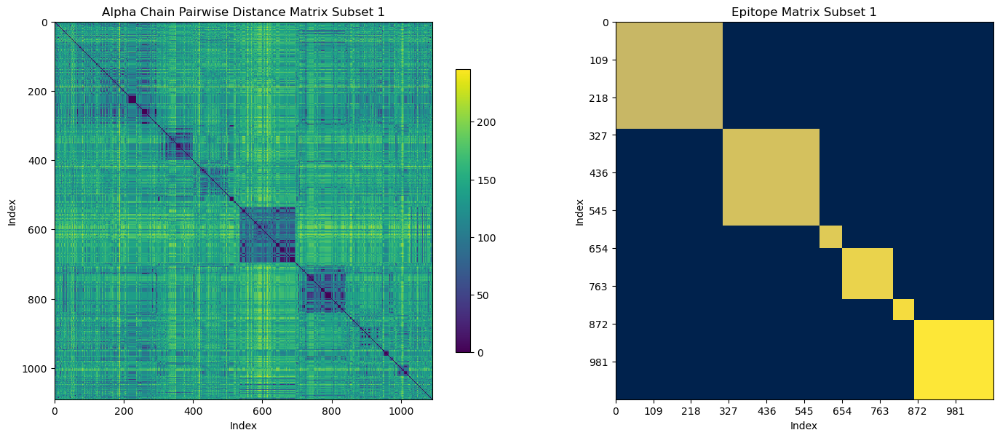

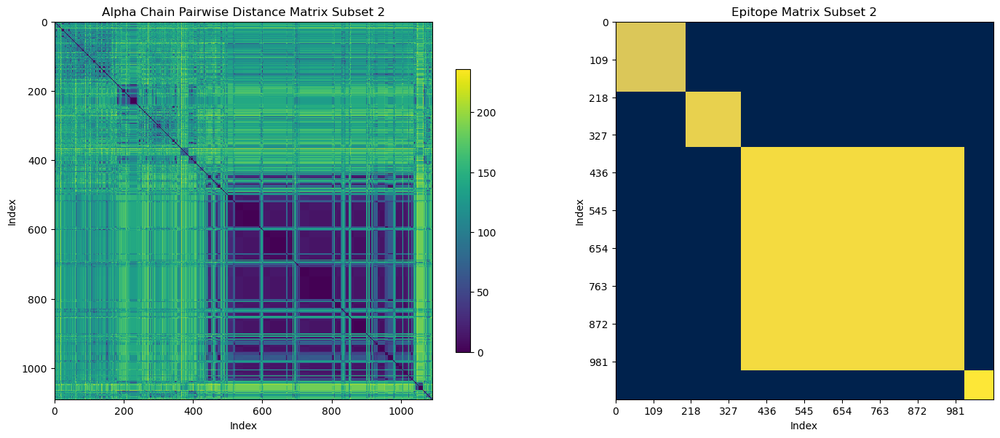

In [56]:
result_mouse_alpha_01 = calculate_and_plot_subsets(mouse_alpha_01,'mouse',['alpha'], 2)

**Note: If the colors are the same in one epitope matrix, it means all the rows belong to the same epitope.**

(68, 9)
(68, 68)


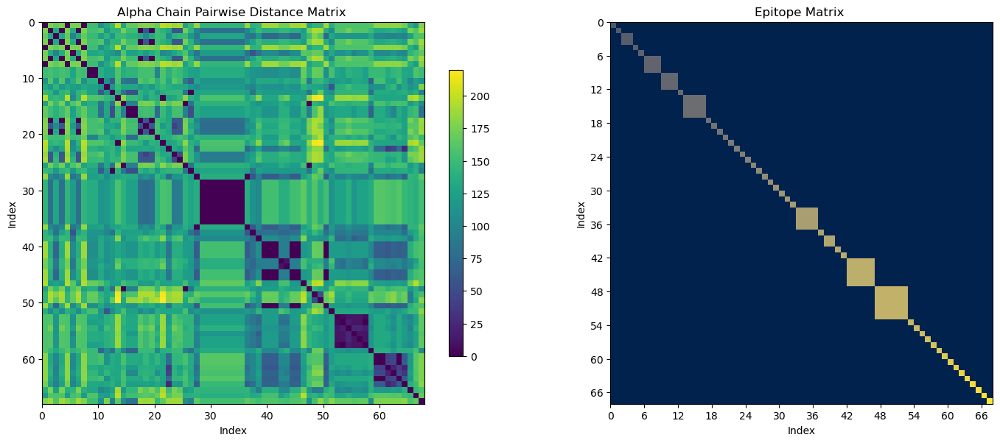

In [57]:
result_mouse_alpha_23 = calculate_and_plot_subsets(mouse_alpha_23,'mouse',['alpha'], 1)

(2785, 9)
(2782, 2782)
(2785, 9)
(2662, 2662)
(2785, 9)
(2698, 2698)
(2785, 9)
(2755, 2755)
no valid results
(2785, 9)
(2785, 2785)
no valid results
(2785, 9)
(2785, 2785)
no valid results
(2785, 9)
(2785, 2785)
no valid results
(2785, 9)
(2785, 2785)
(2785, 9)
(2740, 2740)
(2785, 9)
(2599, 2599)
(2785, 9)
(2767, 2767)
(2785, 9)
(2670, 2670)


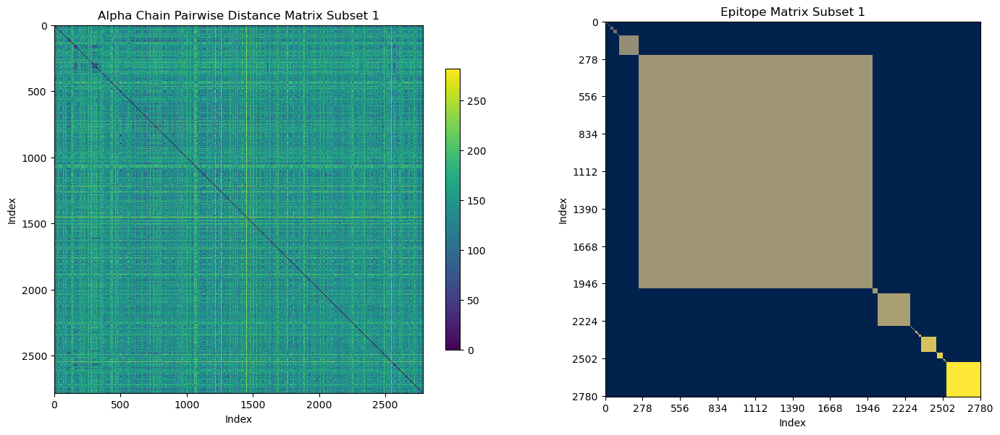

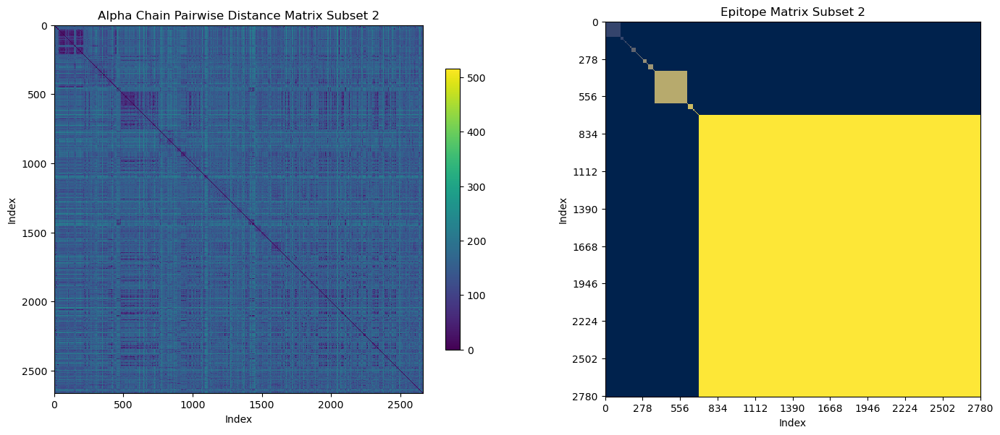

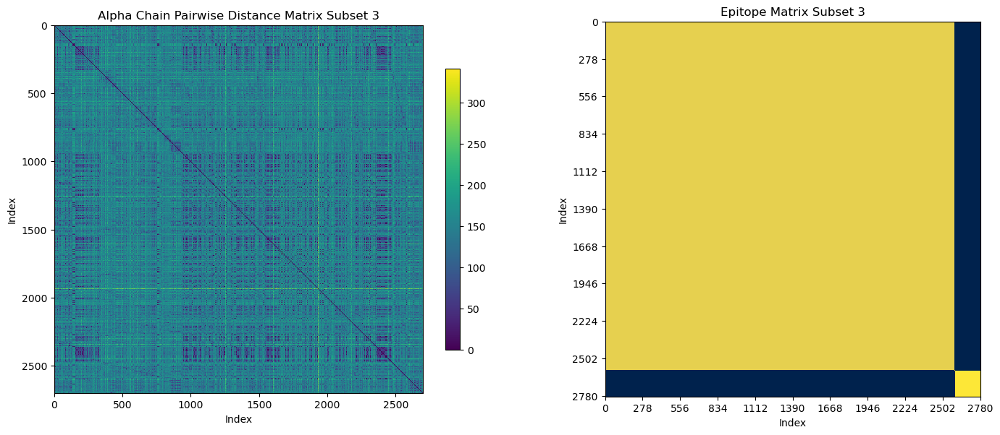

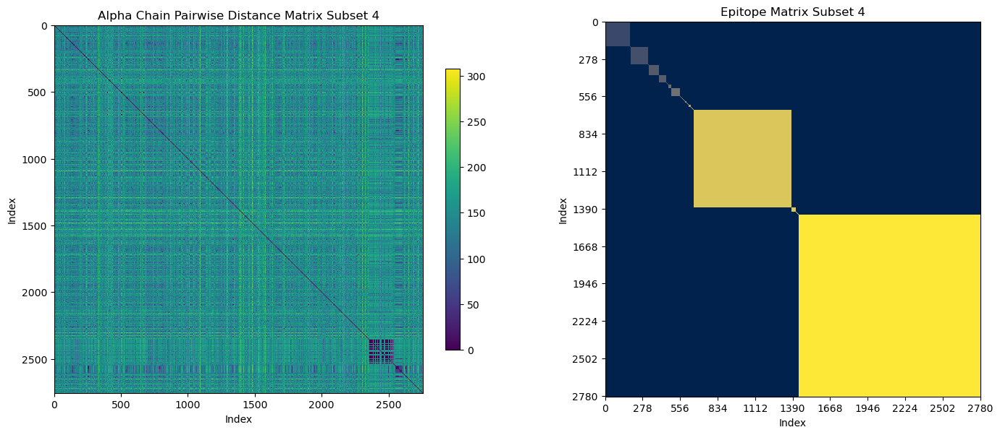

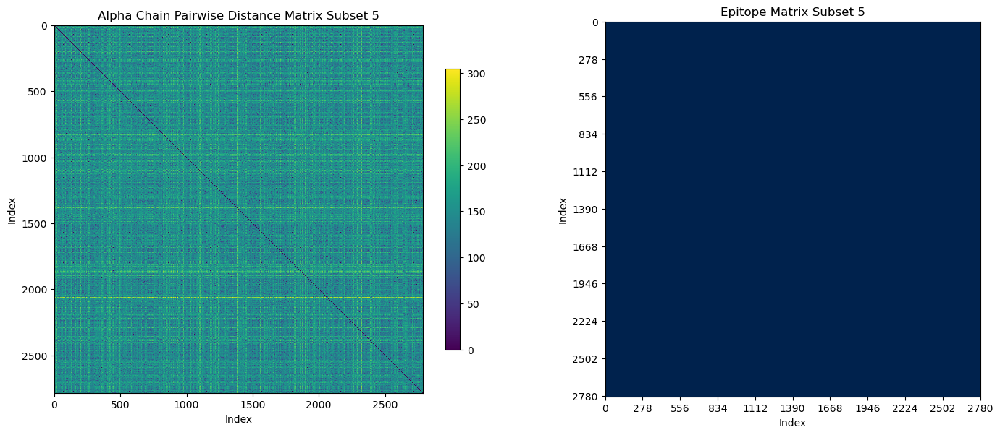

...

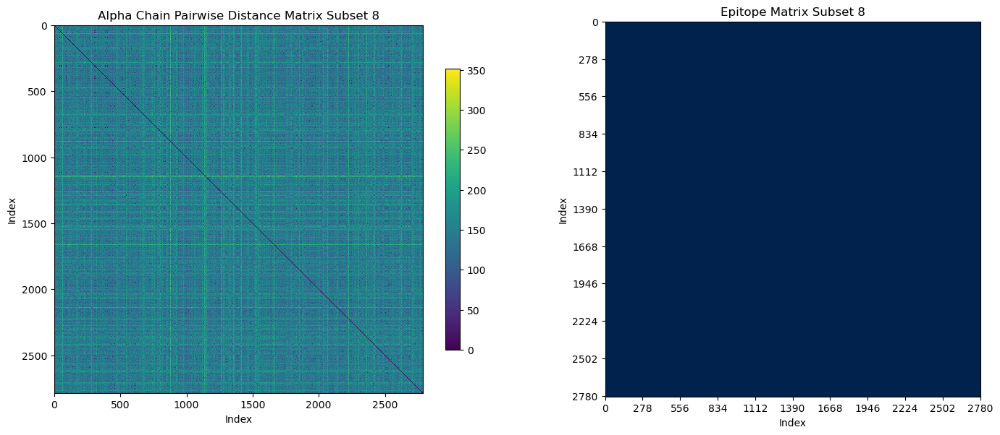

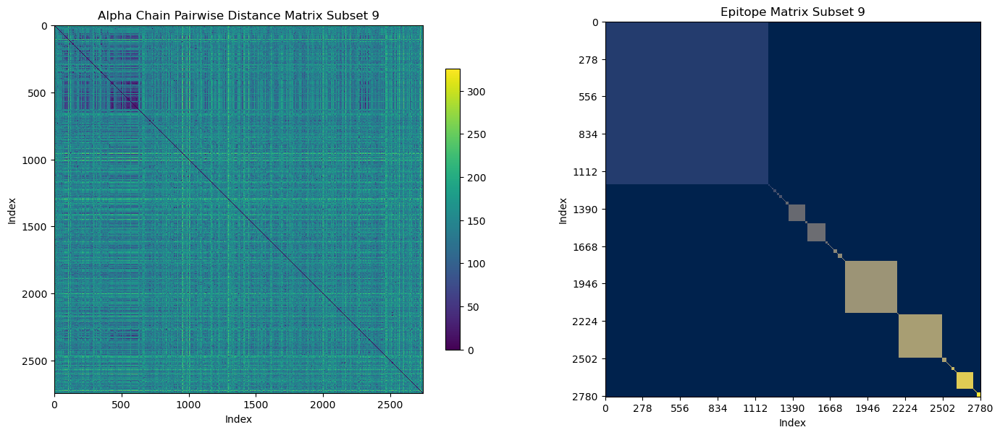

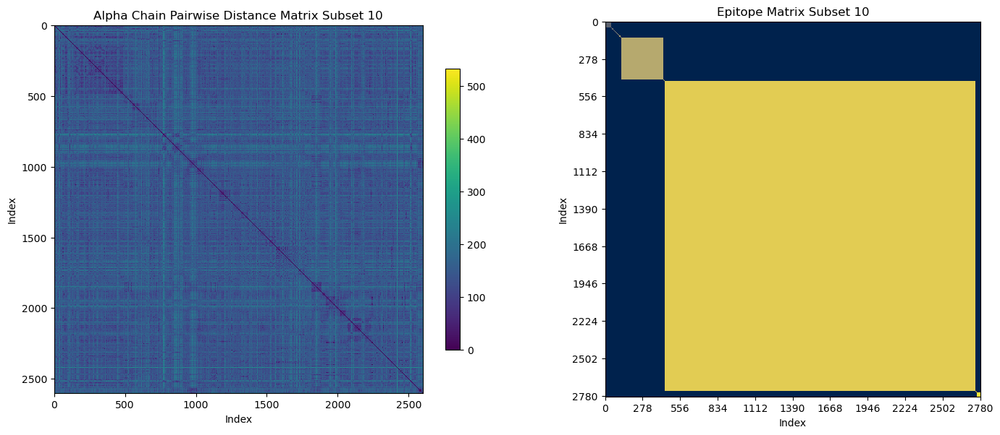

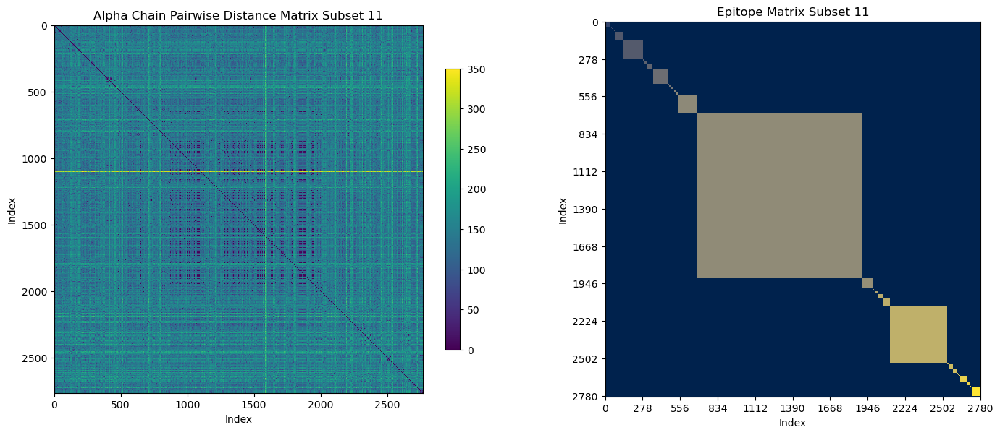

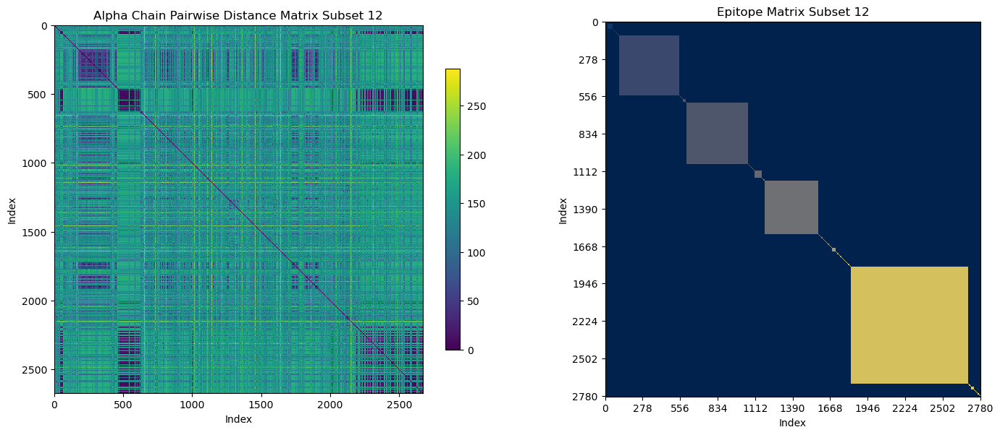

In [58]:
result_human_alpha_01 = calculate_and_plot_subsets(human_alpha_01,'human',['alpha'], 12)

(665, 9)
(631, 631)
(665, 9)
(665, 665)


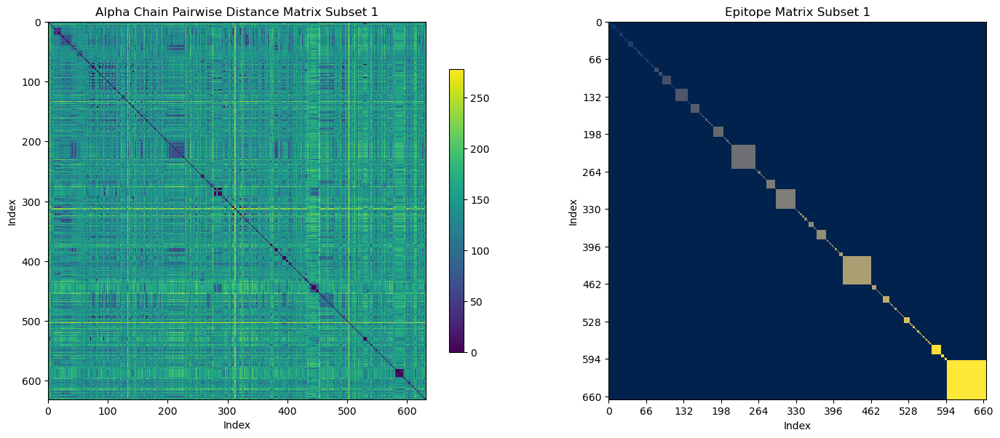

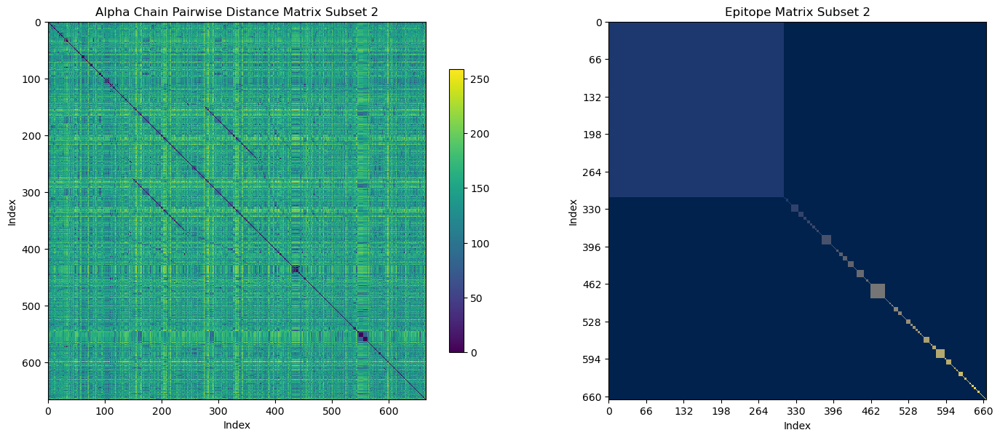

In [59]:
result_human_alpha_23 = calculate_and_plot_subsets(human_alpha_23,'human',['alpha'], 2)

**Beta chain**

In [60]:
mouse_beta_01.nunique()

clone_id       2870
complex_id     2182
organism          1
epitope          12
vdjdb_score       2
count             1
cdr3_b_aa      1814
j_b_gene         13
v_b_gene         23
dtype: int64

In [61]:
a = mouse_beta_01.iloc[:,[1,3,4,6,7,8]]
print(a.columns)
a.duplicated().sum()

Index(['complex_id', 'epitope', 'vdjdb_score', 'cdr3_b_aa', 'j_b_gene',
       'v_b_gene'],
      dtype='object')


163

In [62]:
2870-2707

163

(2870, 9)
(2707, 2707)


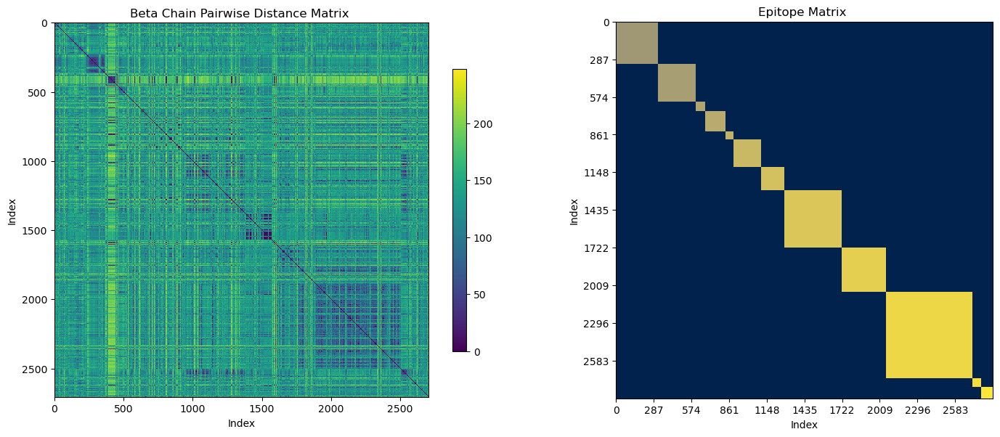

In [63]:
result_mouse_beta_01 = calculate_and_plot_subsets(mouse_beta_01,'mouse',['beta'], 1)

In [64]:
mouse_beta_23.nunique()

clone_id       134
complex_id      70
organism         1
epitope         53
vdjdb_score      2
count            1
cdr3_b_aa       73
j_b_gene        10
v_b_gene        12
dtype: int64

In [65]:
a = mouse_beta_23.iloc[:,[1,3,4,6,7,8]]
print(a.columns)
a.duplicated().sum()

Index(['complex_id', 'epitope', 'vdjdb_score', 'cdr3_b_aa', 'j_b_gene',
       'v_b_gene'],
      dtype='object')


16

In [66]:
134-118

16

In [67]:
mouse_beta_23

,clone_id,complex_id,organism,epitope,vdjdb_score,count,cdr3_b_aa,j_b_gene,v_b_gene
41806,clone_1_192,192,mouse,ADGLAYFRSSFKGG,3.0,1,CASSLNNANSDYTF,TRBJ1-2*01,TRBV26*01
45695,clone_1_227,227,mouse,ADLIAYLEQATKG,3.0,1,CASSLNNANSDYTF,TRBJ1-2*01,TRBV26*01
45584,clone_1_226,226,mouse,ADLIAYLKQATKG,3.0,1,CASSLNWSQDTQYF,TRBJ2-5*01,TRBV26*01
38695,clone_1_164,164,mouse,ADLIAYLKQATKG,3.0,1,CASSLNNANSDYTF,TRBJ1-2*01,TRBV26*01
53472,clone_1_297,297,mouse,ADSLSFFSSSIKRGGGSLVP,3.0,1,CASSLNWSQDTQYF,TRBJ2-5*01,TRBV26*01
...,...,...,...,...,...,...,...,...,...
50749,clone_1_27248,27248,mouse,VVGAVGVGK,2.0,1,CASSRDWGPAEQFF,TRBJ2-1*01,TRBV4*01
50750,clone_1_27249,27249,mouse,VVVGADGVGK,2.0,1,CASSLTDPLDSDYTF,TRBJ1-2*01,TRBV12-2*01
50748,clone_1_27247,27247,mouse,VVVGAVGVGK,2.0,1,CASASWGGYAEQFF,TRBJ2-1*01,TRBV13-1*02
24042,clone_0_80678,0,mouse,VVVGAVGVGK,2.0,1,CTCSADRGAETLYF,TRBJ2-3*01,TRBV1*01


(134, 9)
(118, 118)


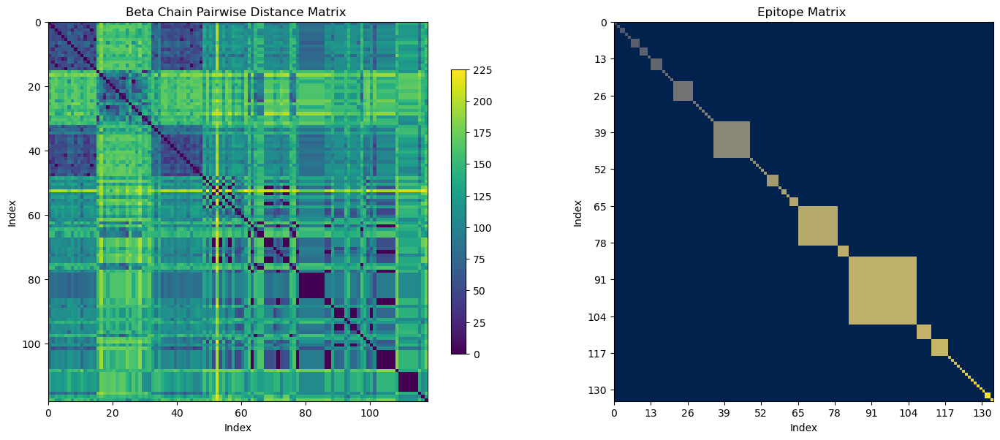

In [68]:
result_mouse_beta_23 = calculate_and_plot_subsets(mouse_beta_23,'mouse',['beta'], 1)

(3145, 9)
(2969, 2969)
(3145, 9)
(2230, 2230)
(3145, 9)
(2895, 2895)
(3145, 9)
(3082, 3082)
(3145, 9)
(2962, 2962)
(3145, 9)
(3089, 3089)
no valid results
(3145, 9)
(3145, 3145)
no valid results
(3145, 9)
(3145, 3145)
no valid results
(3145, 9)
(3145, 3145)
(3145, 9)
(3014, 3014)
(3145, 9)
(2856, 2856)
no valid results
(3145, 9)
(3109, 3109)
(3145, 9)
(3030, 3030)
(3145, 9)
(3080, 3080)
(3145, 9)
(2929, 2929)


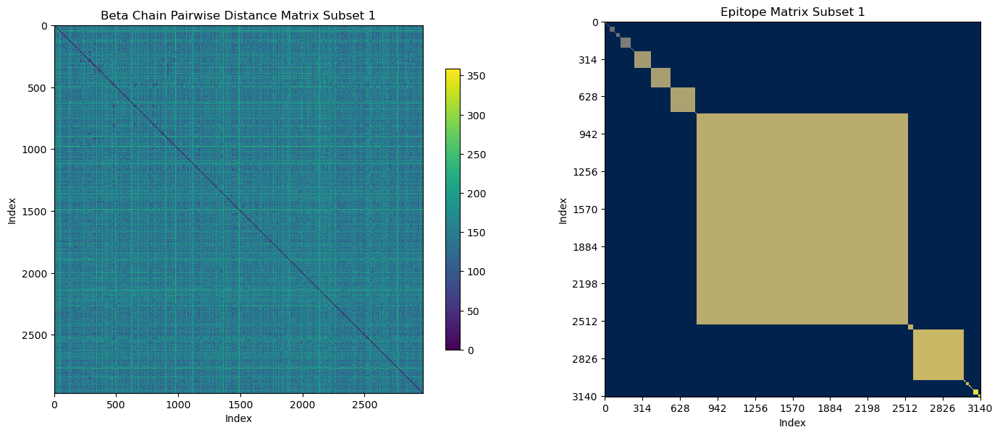

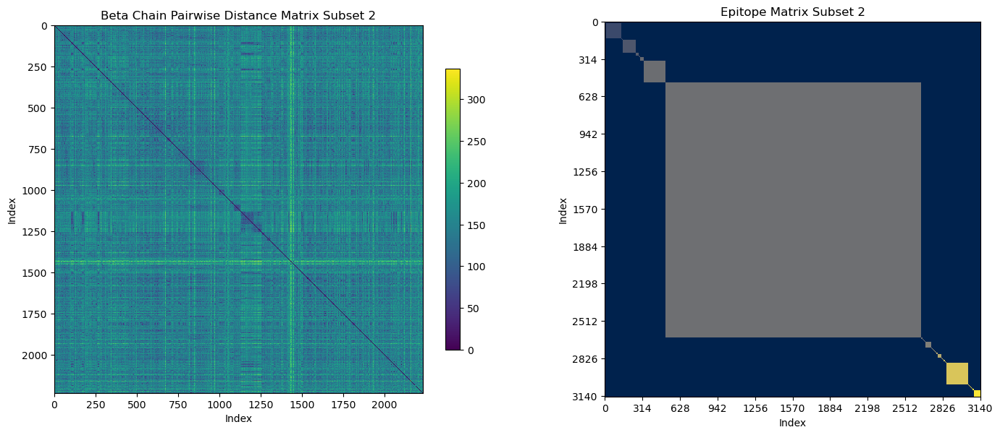

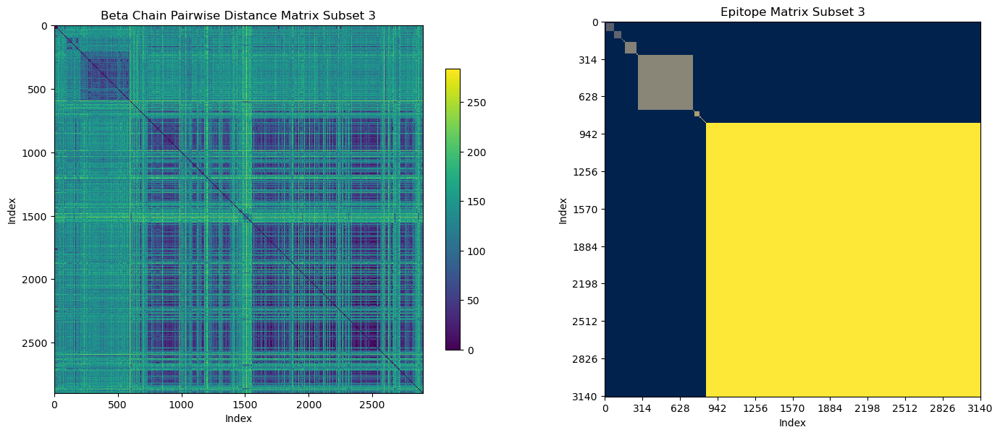

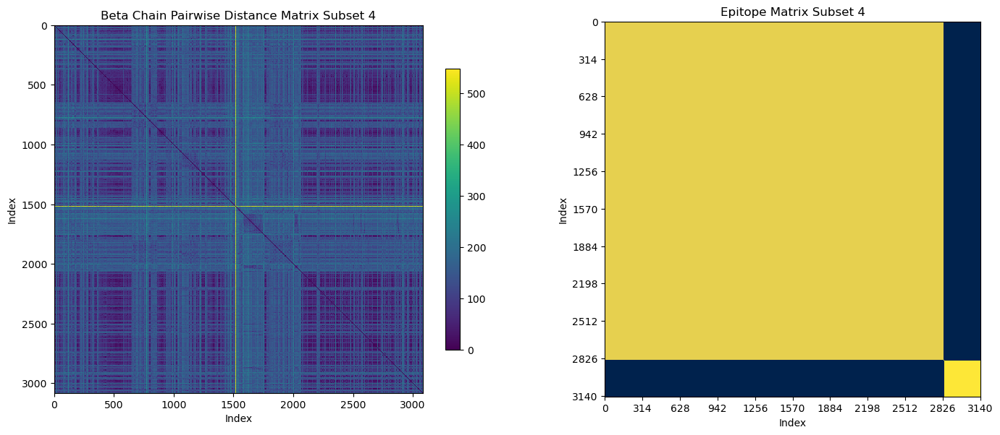

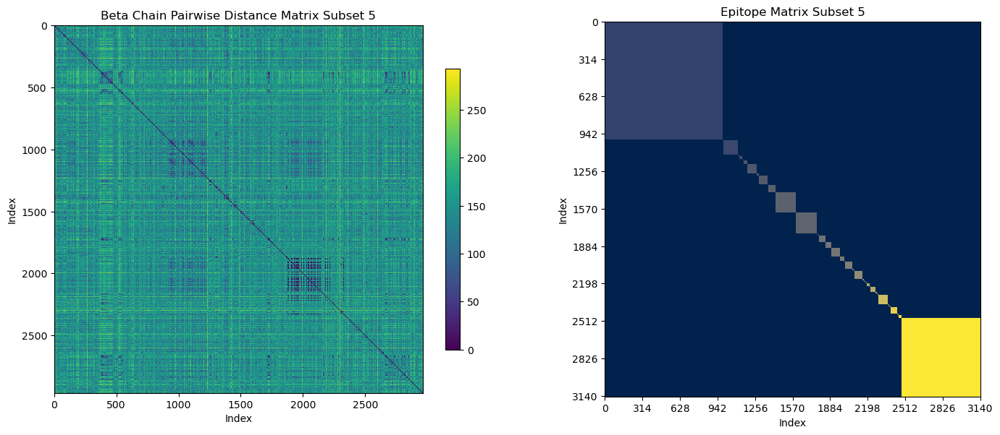

...

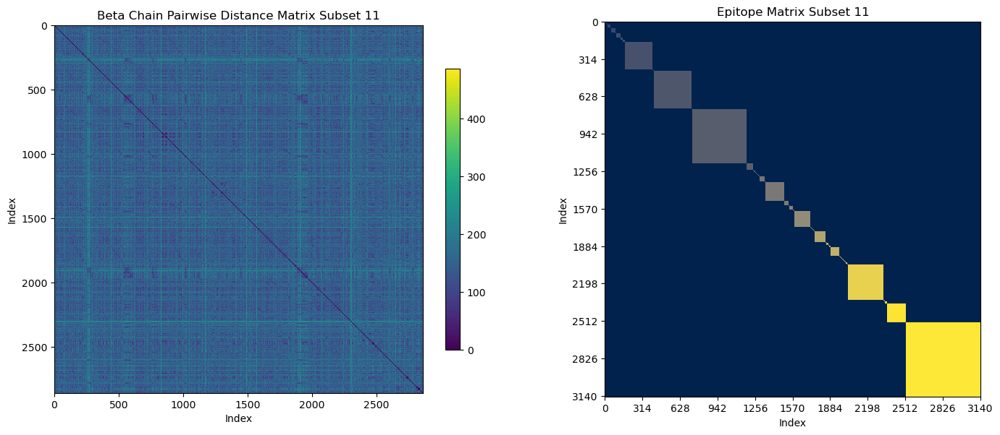

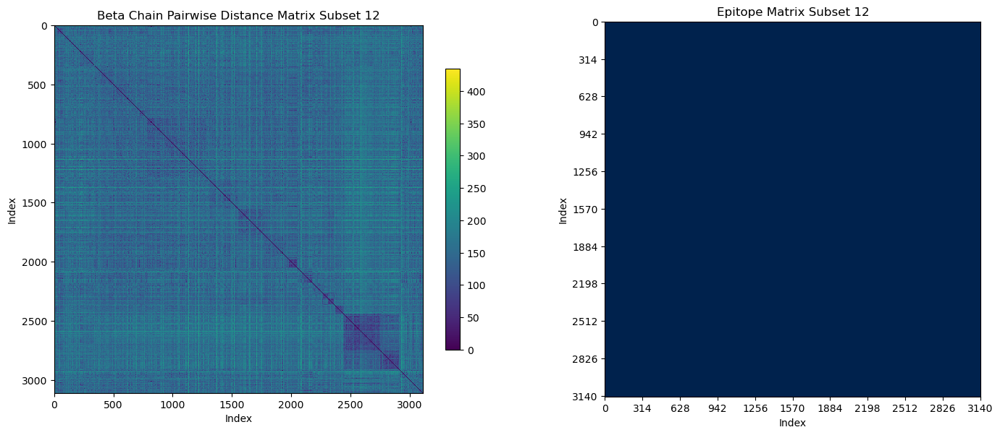

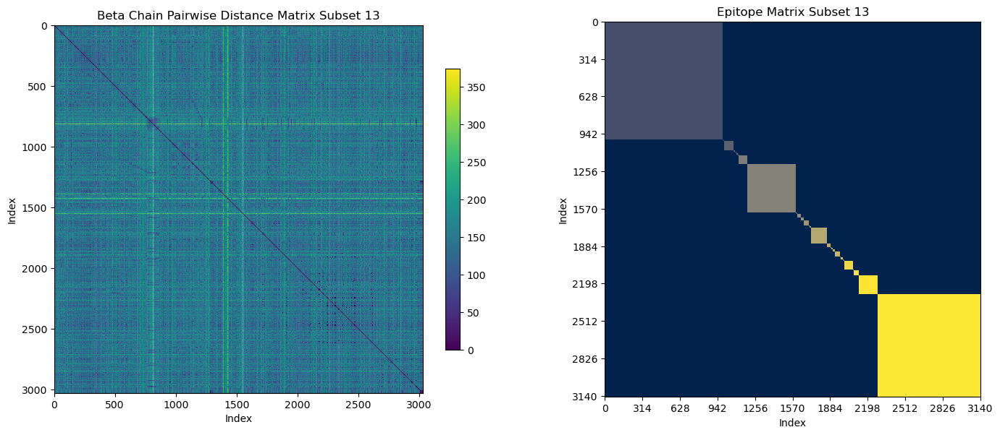

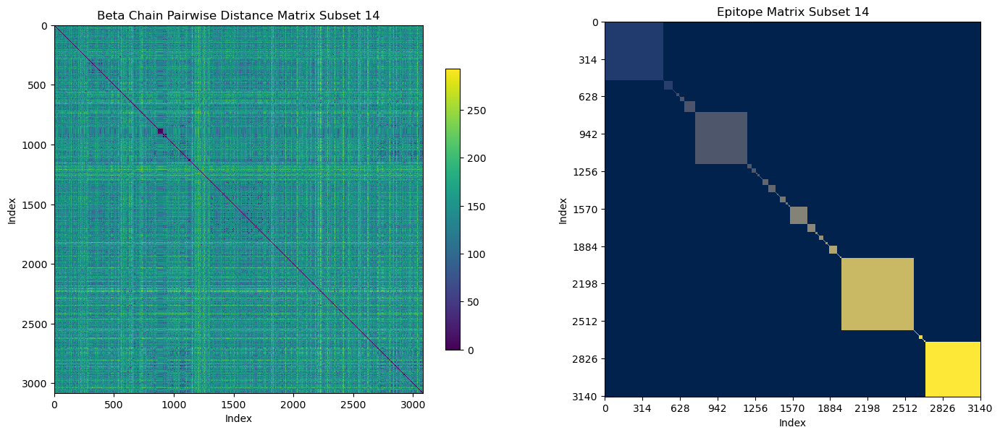

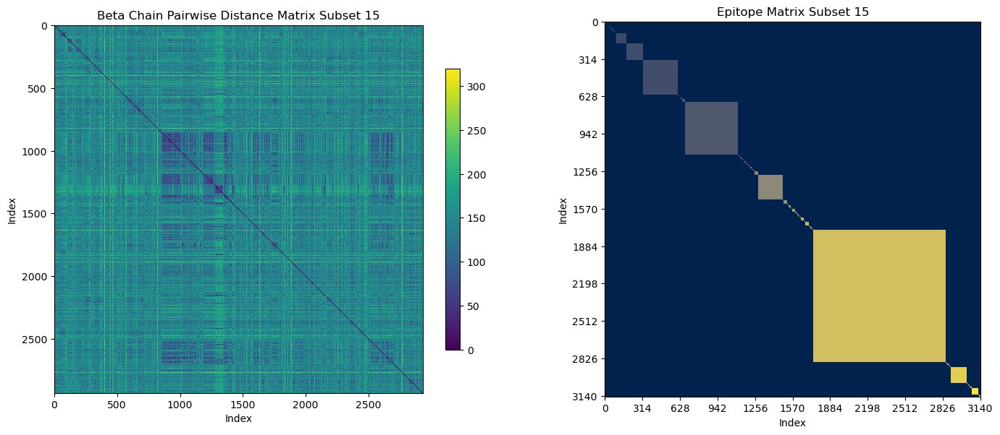

In [69]:
result_human_beta_01 = calculate_and_plot_subsets(human_beta_01,'human',['beta'], 15)

In [70]:
a = human_beta_23.iloc[:,[1,3,6,7,8]]
print(a.columns)
a.duplicated().sum()

Index(['complex_id', 'epitope', 'cdr3_b_aa', 'j_b_gene', 'v_b_gene'], dtype='object')


316

In [71]:
human_beta_23.nunique()

clone_id       2399
complex_id     1250
organism          1
epitope         341
vdjdb_score       2
count             1
cdr3_b_aa      1582
j_b_gene         13
v_b_gene         49
dtype: int64

In [72]:
human_beta_23

,clone_id,complex_id,organism,epitope,vdjdb_score,count,cdr3_b_aa,j_b_gene,v_b_gene
37285,clone_1_1513,1513,human,AAFKRSCLK,3.0,1,CASSQGFGANVLTF,TRBJ2-6*01,TRBV19*01
37296,clone_1_1514,1514,human,AAFKRSCLK,3.0,1,CASVSGQGVSPLHF,TRBJ1-6*01,TRBV19*01
37307,clone_1_1515,1515,human,AAFKRSCLK,3.0,1,CATSRDGAGLVNQPQHF,TRBJ1-5*01,TRBV15*01
37318,clone_1_1516,1516,human,AAFKRSCLK,3.0,1,CASSQDPGSSYNEQFF,TRBJ2-1*01,TRBV4-3*01
37329,clone_1_1517,1517,human,AAFKRSCLK,3.0,1,CASSLNPGRSDSPLHF,TRBJ2-1*01,TRBV7-6*01
...,...,...,...,...,...,...,...,...,...
10632,clone_0_20898,0,human,YVLDHLIVV,2.0,1,CASSTRSSYEQYF,TRBJ2-7*01,TRBV19*01
10630,clone_0_20896,0,human,YVLDHLIVV,2.0,1,CASSIRSAYEQYF,TRBJ2-7*01,TRBV19*01
10631,clone_0_20897,0,human,YVLDHLIVV,2.0,1,CASSFDGVYEQYF,TRBJ2-7*01,TRBV19*01
50734,clone_1_27234,27234,human,YVMAYVMAGVGS,2.0,1,CSAPPLAGDETQYF,TRBJ2-5*01,TRBV20-1*01


(1199, 9)
(1057, 1057)
(1199, 9)
(1044, 1044)


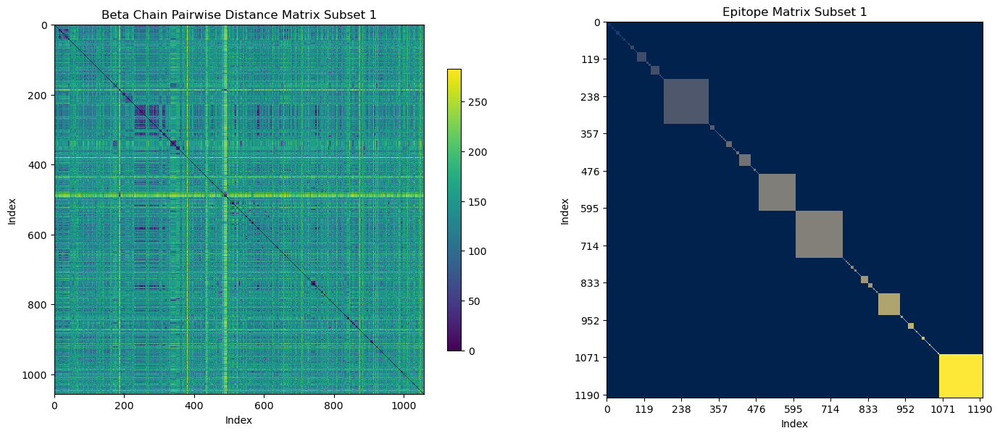

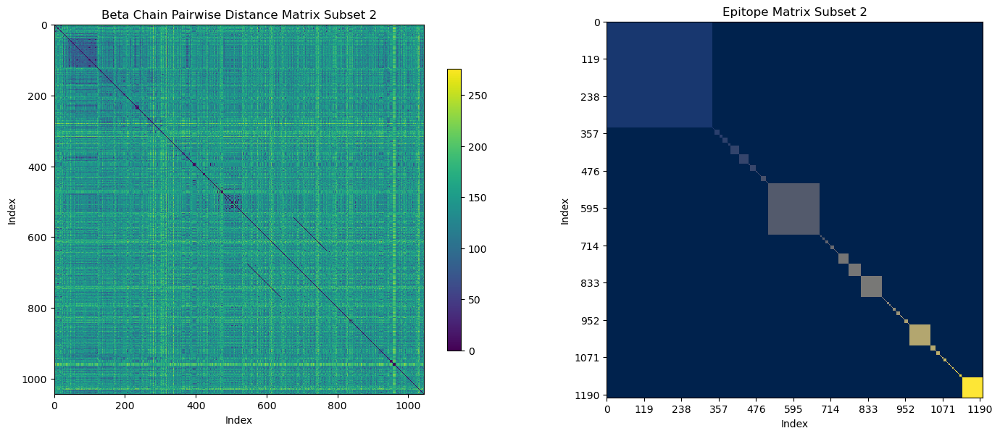

In [73]:
result_human_beta_23 = calculate_and_plot_subsets(human_beta_23,'human',['beta'], 2)

### 1.3.4 Pairwise

(2116, 12)
(2116, 2116)


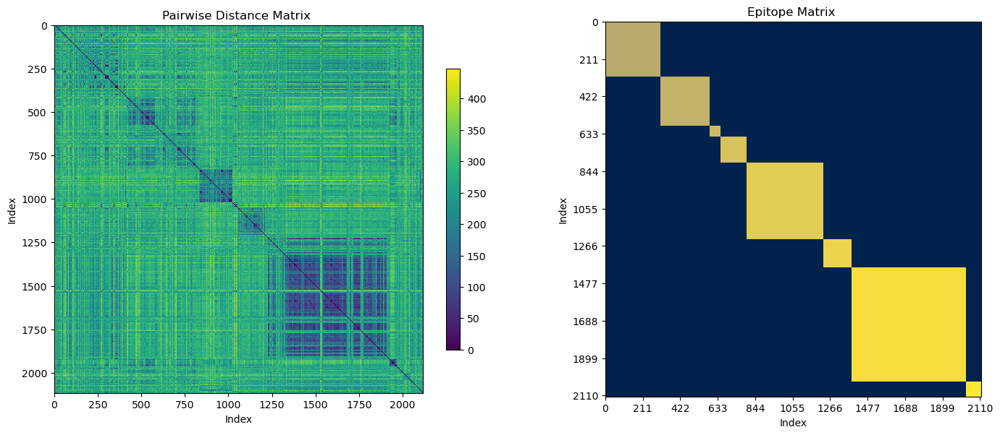

In [74]:
result_mouse_01 = calculate_and_plot_subsets(mouse_01,'mouse',['alpha','beta'], 1)

(68, 12)
(68, 68)


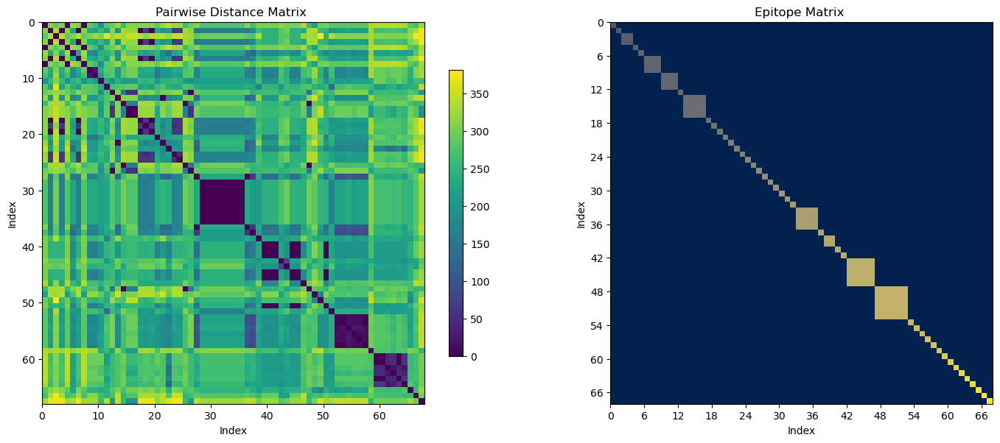

In [75]:
result_mouse_23 = calculate_and_plot_subsets(mouse_23,'mouse',['alpha','beta'], 1)

(2640, 12)
(2640, 2640)
(2640, 12)
(2640, 2640)
(2640, 12)
(2640, 2640)
no valid results
(2640, 12)
(2640, 2640)
no valid results
(2640, 12)
(2640, 2640)
no valid results
(2640, 12)
(2640, 2640)
no valid results
(2640, 12)
(2640, 2640)
(2640, 12)
(2640, 2640)
(2640, 12)
(2640, 2640)
(2640, 12)
(2640, 2640)


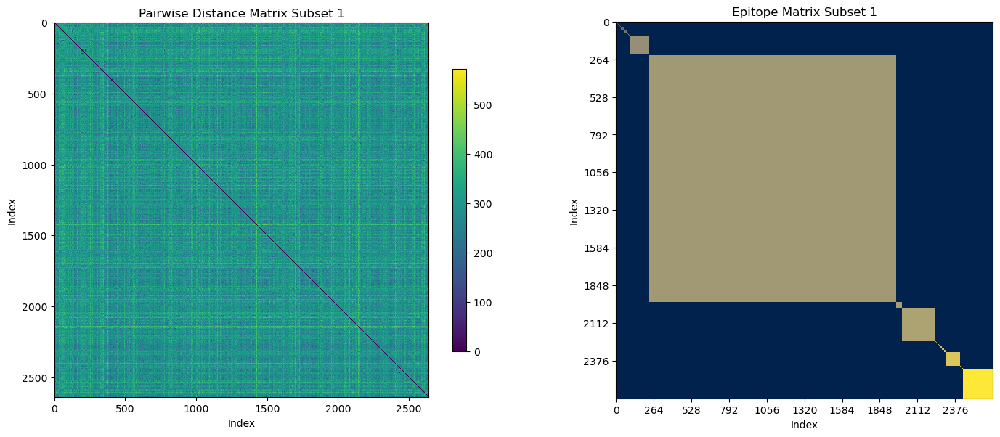

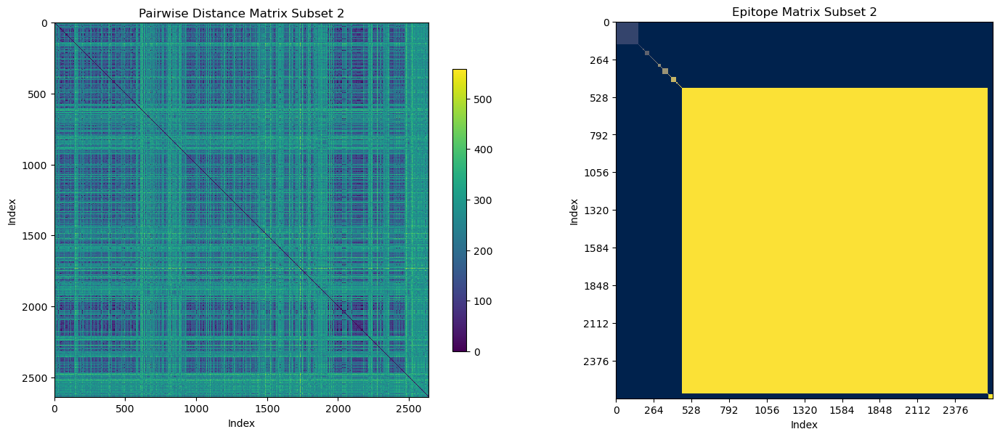

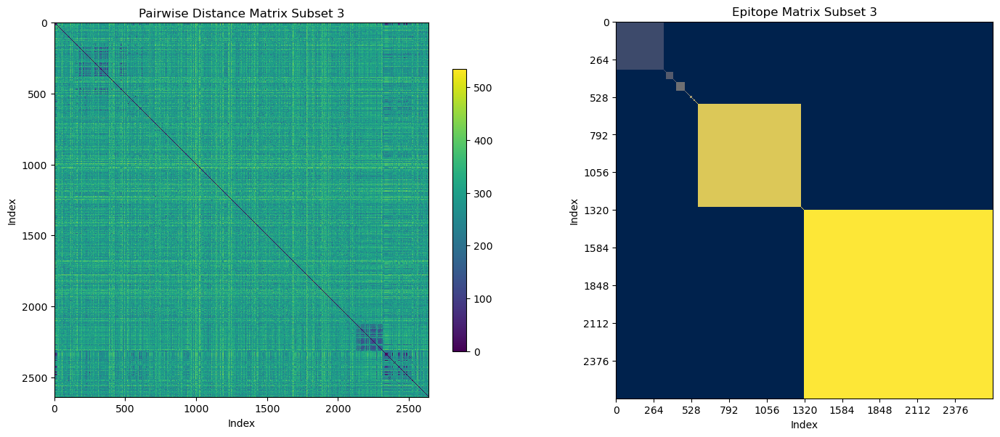

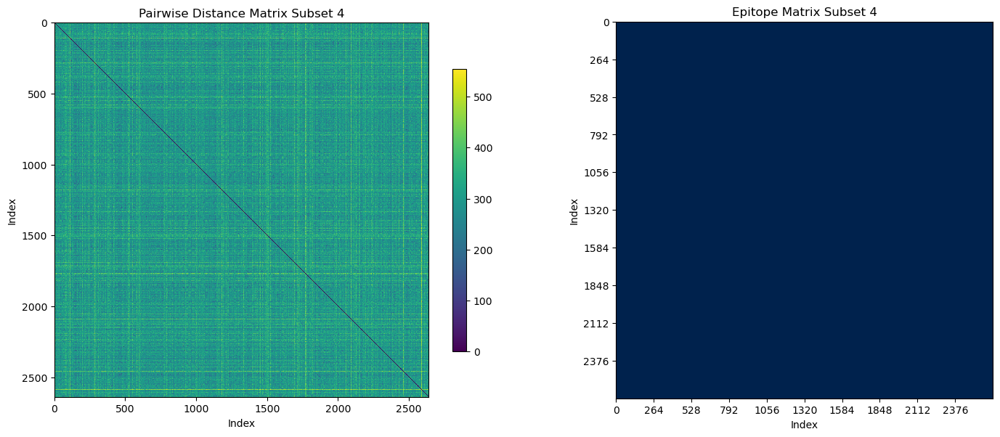

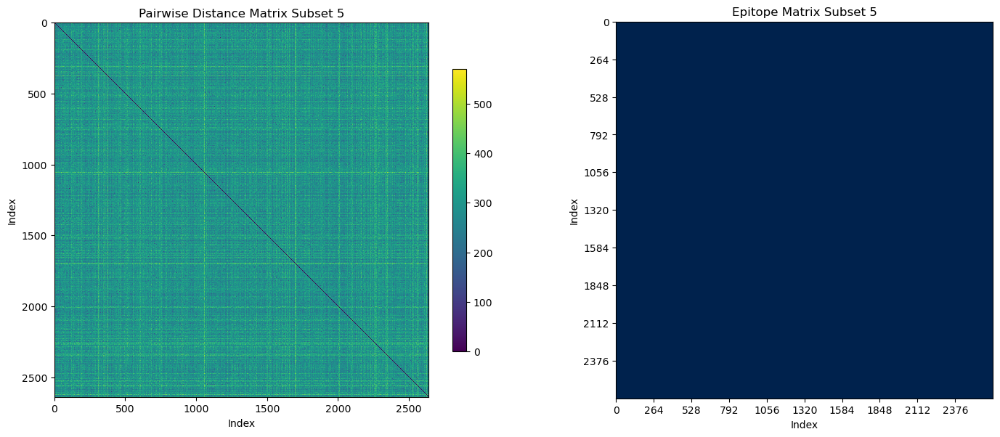

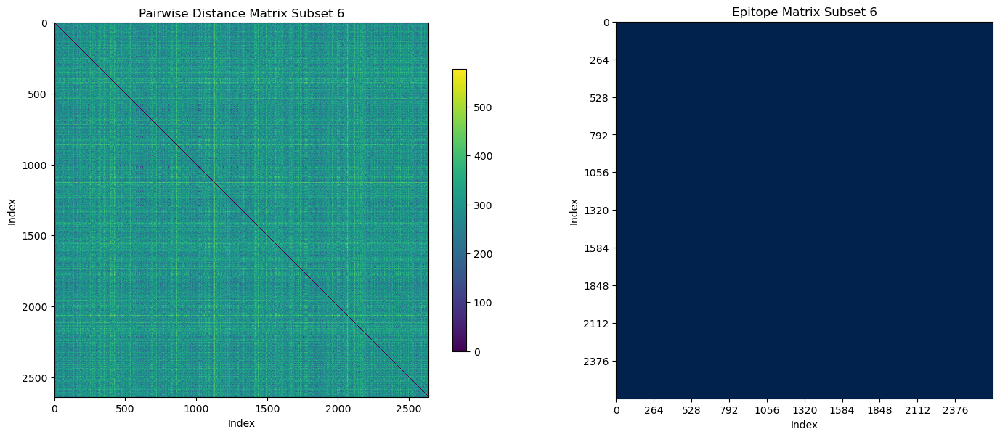

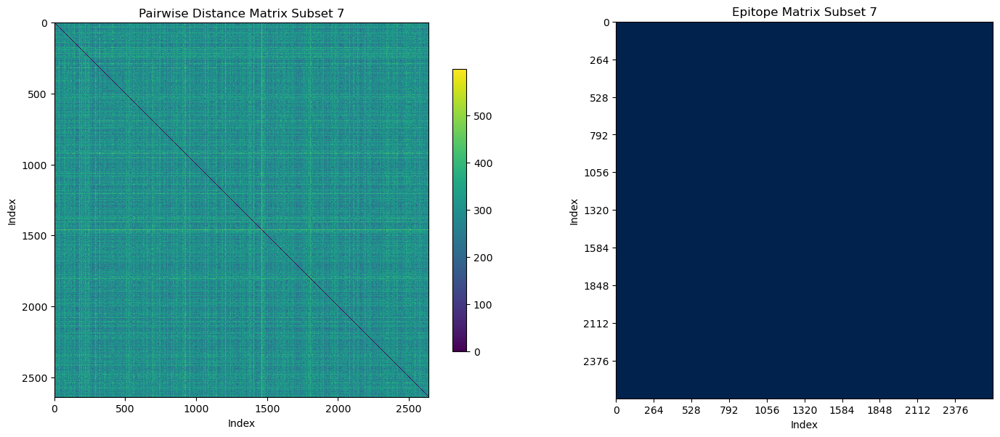

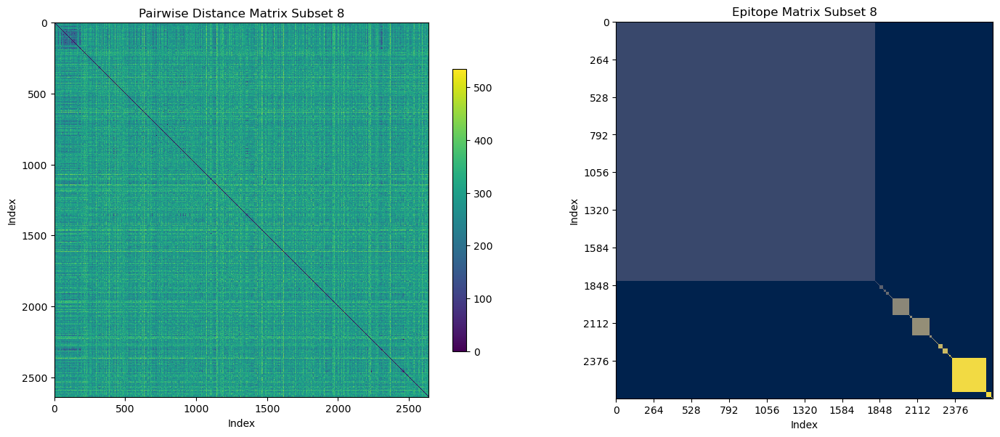

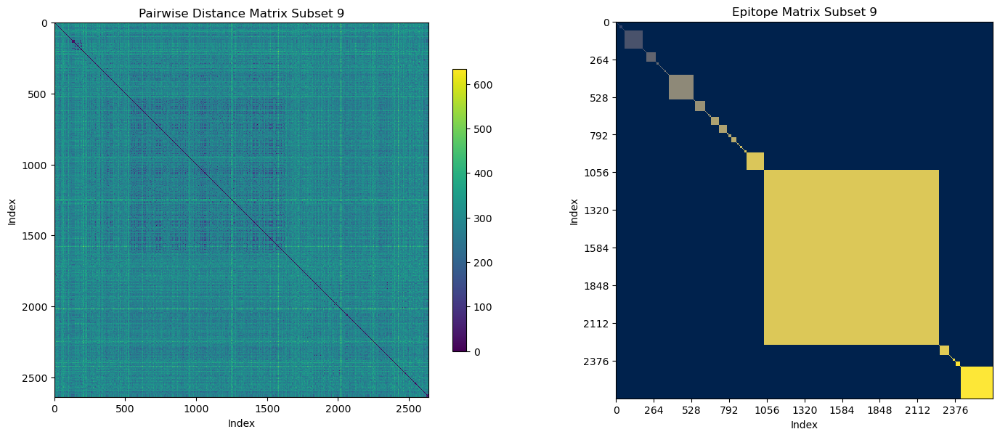

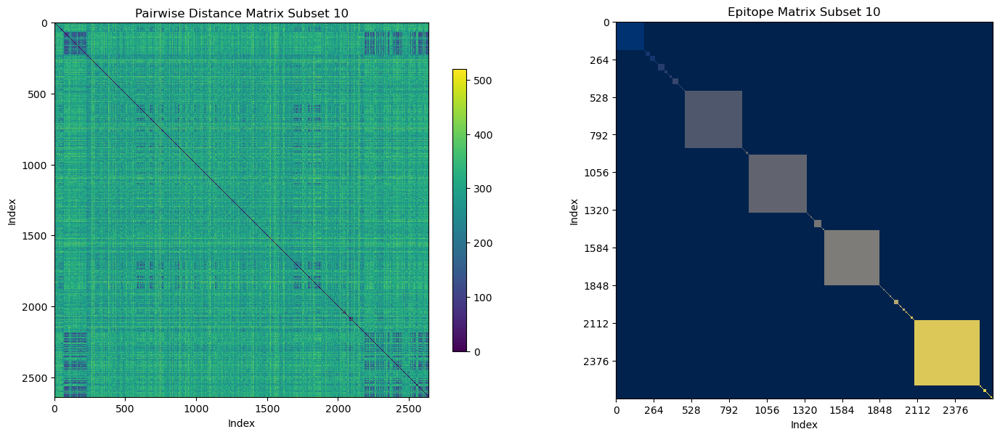

In [76]:
result_human_01 = calculate_and_plot_subsets(human_01,'human',['alpha','beta'], 10)

(1170, 12)
(1170, 1170)


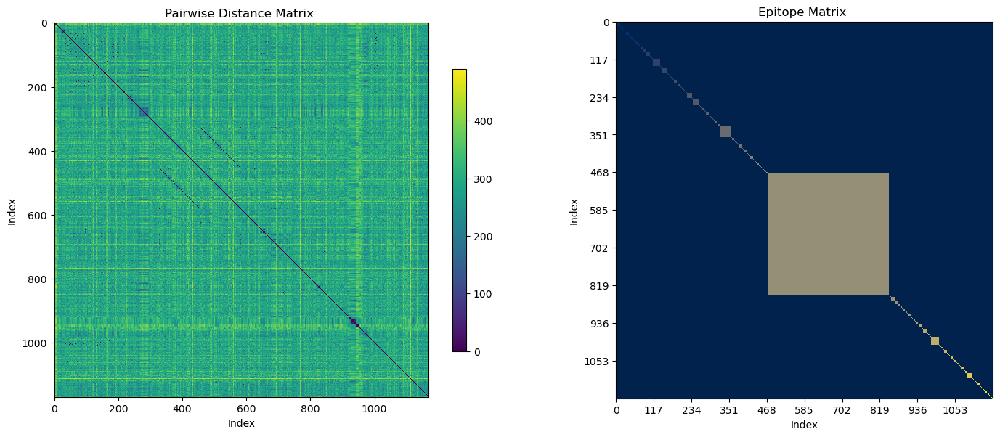

In [77]:
result_human_23 = calculate_and_plot_subsets(human_23,'human',['alpha','beta'], 1)

### 1.3.5 Results evaluation

In [78]:
# List of variables to be integrated
result_variables = [
    result_human_01, result_human_23, result_human_alpha_01, result_human_alpha_23,
    result_human_beta_01, result_human_beta_23, result_mouse_01, result_mouse_23,
    result_mouse_alpha_01, result_mouse_alpha_23, result_mouse_beta_01, result_mouse_beta_23
]

merged_results_df = pd.DataFrame(columns=[
                                 "Dataset", "Silhouette Score", "Davies-Bouldin Index", "Calinski-Harabasz Index"])


for result_variable, dataset_name in zip(result_variables, ["result_human_01", "result_human_23", "result_human_alpha_01",
                                                            "result_human_alpha_23", "result_human_beta_01", "result_human_beta_23",
                                                            "result_mouse_01", "result_mouse_23", "result_mouse_alpha_01",
                                                            "result_mouse_alpha_23", "result_mouse_beta_01", "result_mouse_beta_23"]):
    df = pd.DataFrame(result_variable)
    df["Dataset"] = dataset_name
    merged_results_df = pd.concat([merged_results_df, df])

merged_results_df.reset_index(drop=True, inplace=True)

merged_results_df

,Dataset,Silhouette Score,Davies-Bouldin Index,Calinski-Harabasz Index
0,result_human_01,-0.333291,3.687065,1.648313
1,result_human_01,-0.617694,3.822769,2.104151
2,result_human_01,-0.322218,3.297061,1.777288
3,result_human_01,NaN,NaN,NaN
4,result_human_01,NaN,NaN,NaN
5,result_human_01,NaN,NaN,NaN
6,result_human_01,NaN,NaN,NaN
7,result_human_01,-0.322492,4.251251,1.363343
8,result_human_01,-0.385411,3.858006,1.739852
9,result_human_01,-0.434903,3.189619,3.098216


In [79]:
# 按照数据集名称分组，并计算每列的平均值
grouped_results = merged_results_df.groupby("Dataset").mean()

# 打印结果
grouped_results

,Silhouette Score,Davies-Bouldin Index,Calinski-Harabasz Index
Dataset,,,
result_human_01,-0.402668,3.684295,1.955194
result_human_23,-0.395407,2.128931,1.461875
result_human_alpha_01,-0.415521,3.780664,3.746471
result_human_alpha_23,-0.438065,2.348570,1.491366
result_human_beta_01,-0.379356,4.651009,4.499711
result_human_beta_23,-0.430781,2.581621,1.573121
result_mouse_01,-0.045721,7.416808,126.316684
result_mouse_23,-0.303233,1.428873,1.381134
result_mouse_alpha_01,0.070247,3.815182,141.230794


In [80]:
filtered_results = grouped_results[grouped_results.index.str.endswith("01")]
filtered_results.sort_values(by=filtered_results.columns[0], ascending=False)

,Silhouette Score,Davies-Bouldin Index,Calinski-Harabasz Index
Dataset,,,
result_mouse_alpha_01,0.070247,3.815182,141.230794
result_mouse_beta_01,-0.035653,9.543321,42.845334
result_mouse_01,-0.045721,7.416808,126.316684
result_human_beta_01,-0.379356,4.651009,4.499711
result_human_01,-0.402668,3.684295,1.955194
result_human_alpha_01,-0.415521,3.780664,3.746471


In [81]:
filtered_results = grouped_results[grouped_results.index.str.endswith("23")]
filtered_results.sort_values(by=filtered_results.columns[0], ascending=False)

,Silhouette Score,Davies-Bouldin Index,Calinski-Harabasz Index
Dataset,,,
result_mouse_alpha_23,-0.297013,1.411822,1.375650
result_mouse_23,-0.303233,1.428873,1.381134
result_mouse_beta_23,-0.313336,1.667851,2.276854
result_human_23,-0.395407,2.128931,1.461875
result_human_beta_23,-0.430781,2.581621,1.573121
result_human_alpha_23,-0.438065,2.348570,1.491366


In [82]:
# Calculate the Silhouette score. 
# The closer to 1, the better.

# Calculate the Davis-Bourdin index. 
# The smaller the index value, the higher the tightness within
# the cluster and the better the separation between clusters.


# Calculate the Calinski-Harabasz index. 
# The larger the index value, the better the clustering result.